# Ensemble attack
Test an extreme scenario of overfitting - synthetic data is copy of real data

# 1. Initiation

In [3]:
# Standard library
import sys

sys.path.append("..")

from pathlib import Path

# 3rd party packages
import pandas as pd

# Local packages
import src.data.real_data as real_data
from clover.metrics.utility.report import UtilityReport
from src import config
from src.attack import (
    LOGAN,
    Detector,
    Ensemble,
    GAN_Leaks,
    Monte_Carlo,
    TableGAN,
    blending,
    blending_plus,
    soft_voting,
    stacking,
    stacking_plus,
)
from src.utils import draw

# 2. Data preparation

## 2.1 Split the real data

In [2]:
generator = "copy"  # We'll just make a copy of the real data as the synthetic data

(
    df_real_train,
    df_real_control_detector,
    df_real_control_val,
    df_real_control_test,
) = real_data.split_real_data(
    data_path=config.DATASET_FILEPATH,
    seed=config.seed,
    var_to_predict=config.metadata["variable_to_predict"],
    save_folder=config.OUTPUT_PATH / generator / "data" / "real",
)

## 2.2 First and second generation synthetic data

In [3]:
# 1st generation

synth_train_size = (
    len(df_real_train) * 2
)  # The size is 2x of df_real_train, because it will be split into 2 for the 2-steps training of TableGAN
synth_test_size = len(df_real_train)  # Used to train TableGAN

df_synth_train = df_real_train.sample(
    n=synth_train_size,
    replace=True,
    ignore_index=True,
    random_state=config.seed,
)
df_synth_test = df_real_train.sample(
    n=synth_test_size,
    replace=True,
    ignore_index=True,
    random_state=config.seed,
)

# 2nd generation
df_synth_2nd = df_synth_train.sample(
    n=synth_test_size,
    replace=True,
    ignore_index=True,
    random_state=config.seed,
)

## 2.3 Generate utility report

In [4]:
df_real_dict = {"train": df_real_train, "test": df_real_control_test}
df_synth_dict = {
    "train": df_synth_train.sample(
        n=len(df_real_train),
        replace=False,
        ignore_index=True,
        random_state=config.seed,
    ),
    "test": df_synth_test.sample(
        n=len(df_real_control_test),
        replace=False,
        ignore_index=True,
        random_state=config.seed,
    ),
}

report = UtilityReport(
    dataset_name="Dataset",
    df_real=df_real_dict,
    df_synthetic=df_synth_dict,
    metadata=config.metadata,
    figsize=(8, 6),
    random_state=config.seed,
    report_filepath=None,
    metrics=None,
    cross_learning=False,
    num_repeat=1,  # for the metrics relying on predictions to account for randomness
    num_kfolds=3,  # the number of folds to tune the hyperparameters for the metrics relying on predictors
    num_optuna_trials=20,  # the number of trials of the optimization process for tuning hyperparameters for the metrics relying on predictors
    use_gpu=True,  # run the learning tasks on the GPU
    alpha=0.05,  # for the pairwise chi-square metric
)
report.compute()
report.summary().groupby(["name", "objective", "min", "max"]).apply(
    lambda x: x.drop(["name", "objective", "min", "max"], axis=1).reset_index(drop=True)
)

alias  \
name                                          objective min max                            
Categorical Consistency                       max       0   1.0 0             cat_consis   
Categorical Statistics                        max       0   1.0 0              cat_stats   
                                                                1              cat_stats   
Classification                                min       0   1.0 0                classif   
Continuous Consistency                        max       0   1.0 0            cont_consis   
Continuous Statistics                         min       0   inf 0             cont_stats   
                                                                1             cont_stats   
Distinguishability                            min       0   1.0 0                   dist   
                                                                1                   dist   
                                                                2                   dist   
                                                                3                   dist   
FScore                                        min       0   inf 0                 fscore   
Feature Importance                            min       0   inf 0            feature_imp   
Hellinger Categorical Univariate Distance     min       0   1.0 0     hell_cat_univ_dist   
Hellinger Continuous Univariate Distance      min       0   1.0 0    hell_cont_univ_dist   
KL Divergence Categorical Univariate Distance min       0   inf 0   kl_div_cat_univ_dist   
KL Divergence Continuous Univariate Distance  min       0   inf 0  kl_div_cont_univ_dist   
Pairwise Chi Square Difference                max       0   1.0 0                   pcsd   
                                                                1                   pcsd   
Pairwise Correlation Difference               min       0   inf 0                    pcd   

                                                                                     submetric  \
name                                          objective min max                                  
Categorical Consistency                       max       0   1.0 0                 within_ratio   
Categorical Statistics                        max       0   1.0 0             support_coverage   
                                                                1           frequency_coverage   
Classification                                min       0   1.0 0              diff_real_synth   
Continuous Consistency                        max       0   1.0 0                 within_ratio   
Continuous Statistics                         min       0   inf 0           median_l1_distance   
                                                                1              iqr_l1_distance   
Distinguishability                            min       0   1.0 0               prediction_mse   
                                                                1          prediction_mse_real   
                                                                2         prediction_mse_synth   
                                                                3      prediction_auc_rescaled   
FScore                                        min       0   inf 0                 diff_f_score   
Feature Importance                            min       0   inf 0  diff_permutation_importance   
Hellinger Categorical Univariate Distance     min       0   1.0 0           hellinger_distance   
Hellinger Continuous Univariate Distance      min       0   1.0 0           hellinger_distance   
KL Divergence Categorical Univariate Distance min       0   inf 0                kl_divergence   
KL Divergence Continuous Univariate Distance  min       0   inf 0                kl_divergence   
Pairwise Chi Square Difference                max       0   1.0 0                  sensitivity   
                                                                1                  specificity   


In [5]:
report.save(
    savepath=config.OUTPUT_PATH / generator / "report", filename="utility_report"
)

## 2.4 Build train, validation and test sets

In [5]:
cat_cols = [
    col for col in df_real_train.columns if col not in config.metadata["continuous"]
]
cont_cols = [col for col in df_real_train.columns if col not in cat_cols]

In [6]:
# LOGAN
df_train_logan, y_train_logan = LOGAN.prepare_data(
    df_synth_train=df_synth_train,
    df_synth_2nd=df_synth_2nd,
    size=len(df_real_train),
    cat_cols=cat_cols,
    seed=config.seed,
)

# TableGAN
(
    df_train_tablegan_discriminator,
    y_train_tablegan_discriminator,
    df_train_tablegan_classifier,
    y_train_tablegan_classifier,
) = TableGAN.prepare_data(
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_synth_2nd=df_synth_2nd,
    size=len(df_synth_test),
    cat_cols=cat_cols,
    seed=config.seed,
)

# Detector
df_train_detector, y_train_detector = Detector.prepare_data(
    df_real_control_detector=df_real_control_detector,
    df_synth_train=df_synth_train,
    size=len(df_real_control_detector),
    cat_cols=cat_cols,
    seed=config.seed,
)

# Validation (for ensemble) and test sets
df_val, y_val, df_test, y_test = Ensemble.prepare_data(
    df_real_train=df_real_train,
    df_real_control_val=df_real_control_val,
    df_real_control_test=df_real_control_test,
    cat_cols=cat_cols,
    seed=config.seed,
)

# 3. Membership inference attack

In [7]:
iteration = 10

GANLeaks


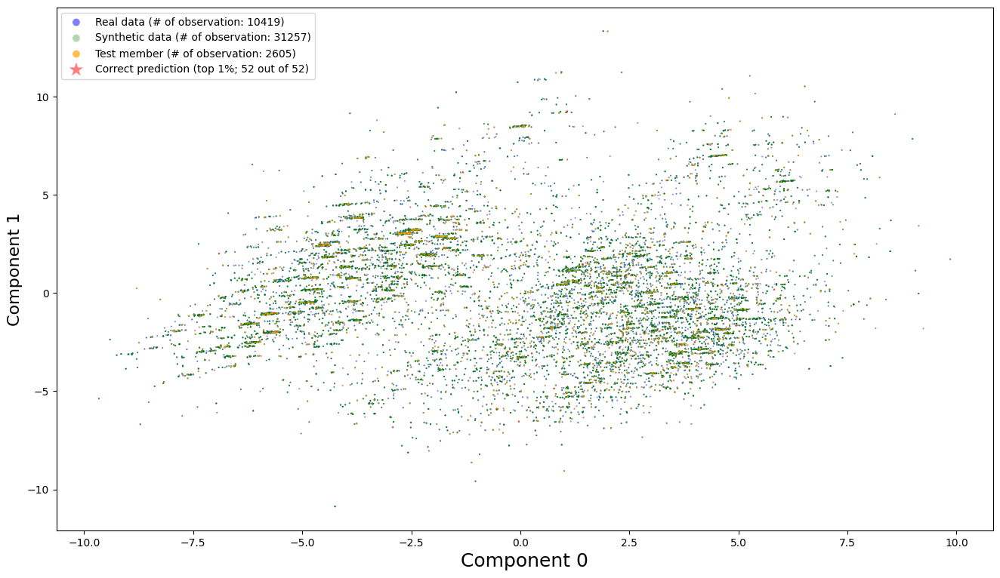

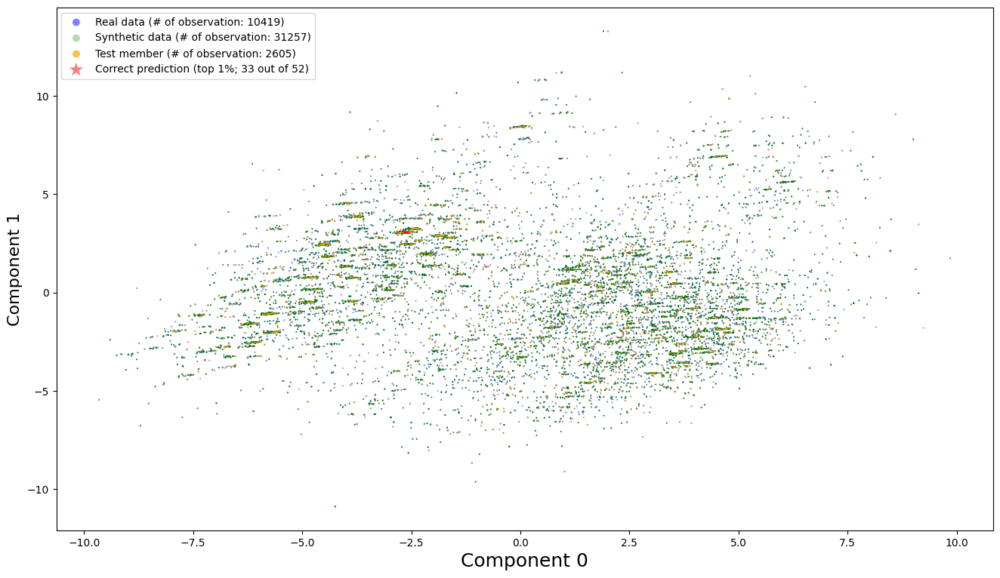

LOGAN


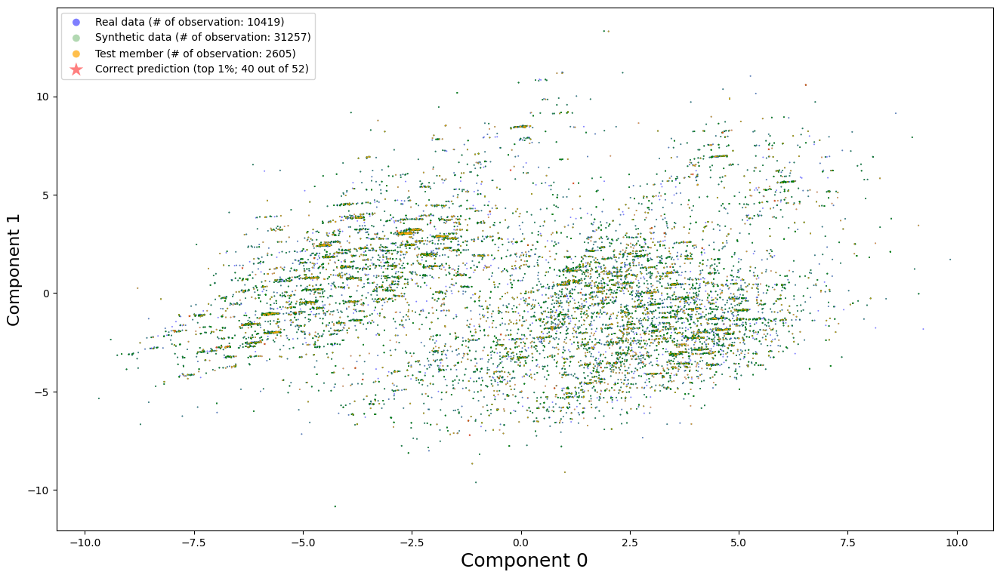

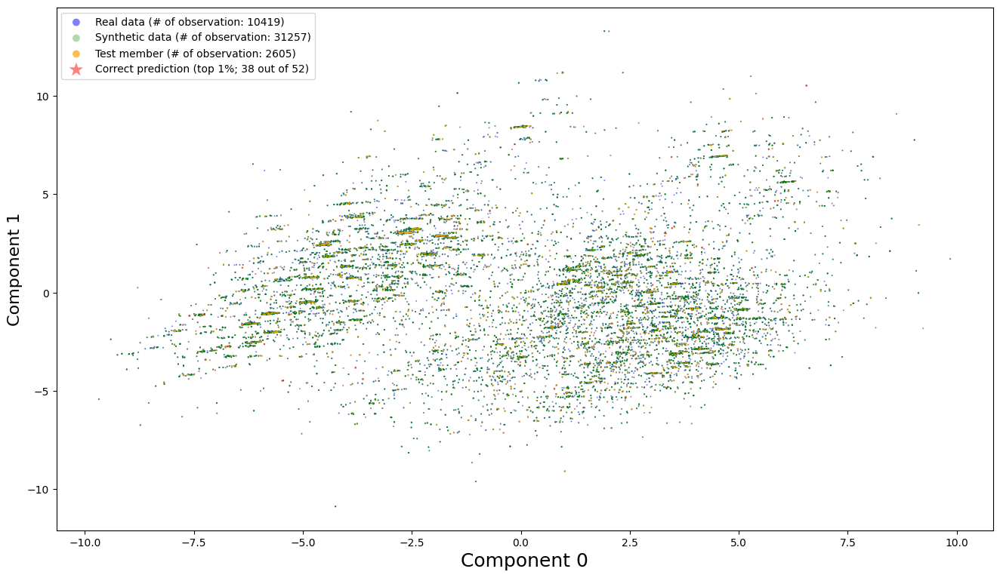

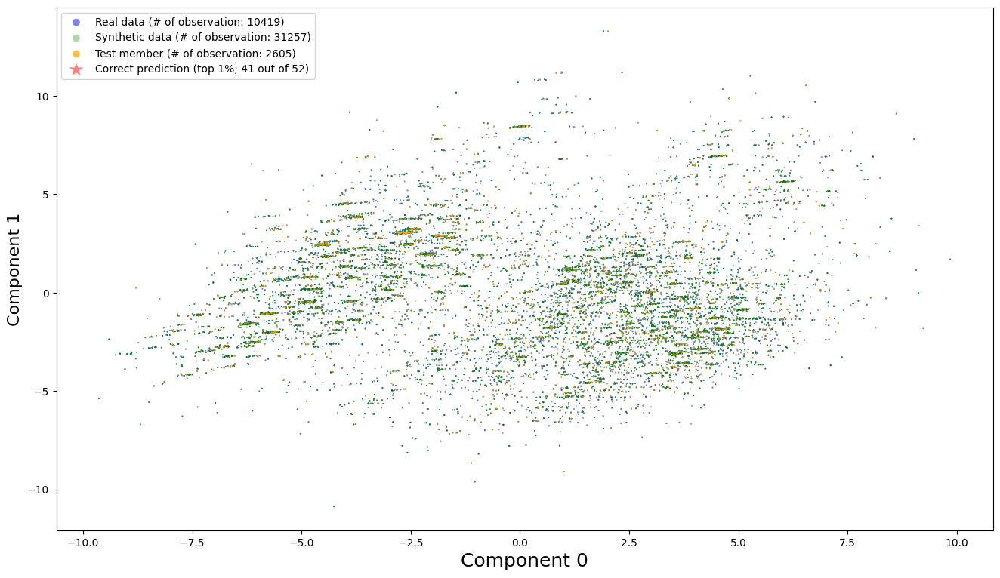

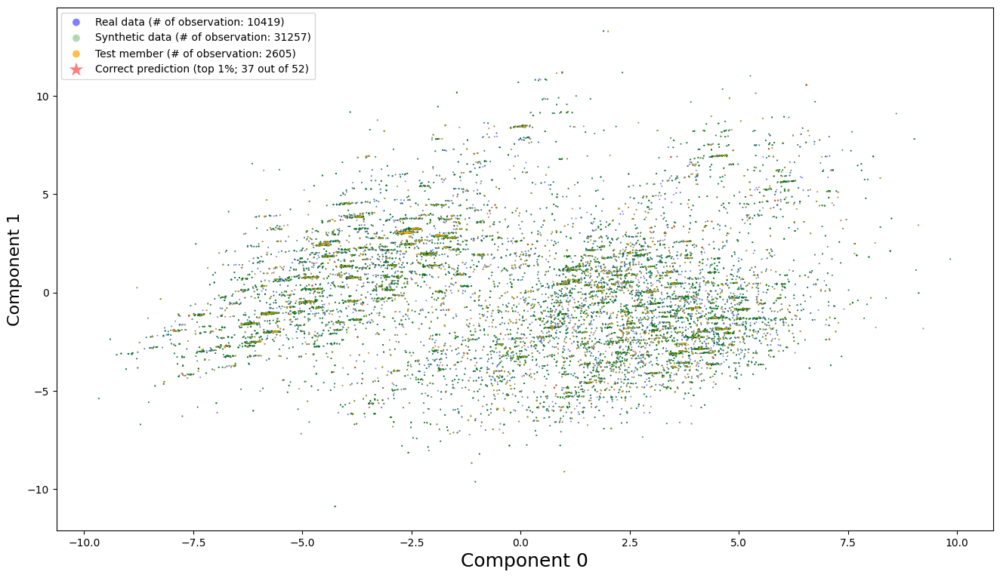

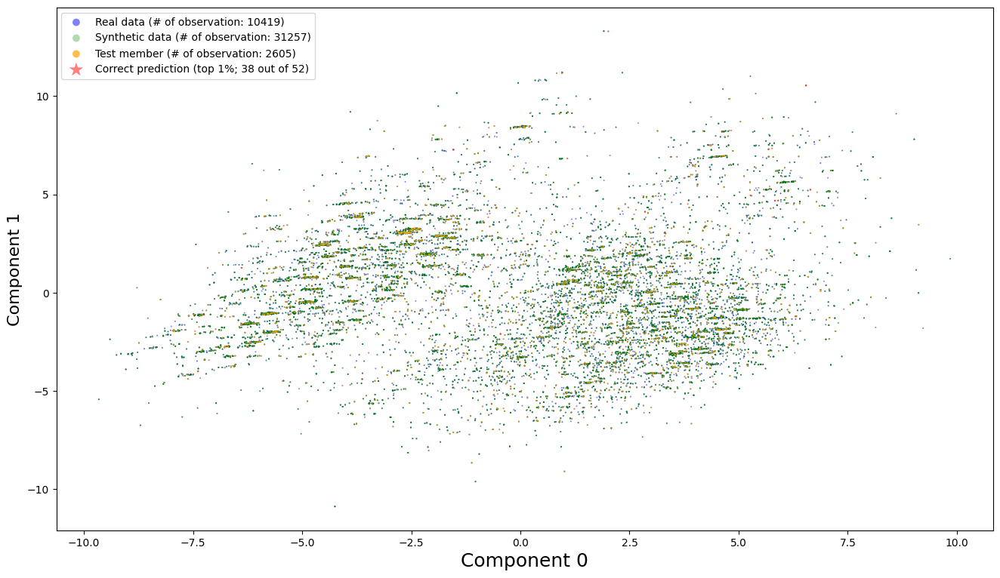

...

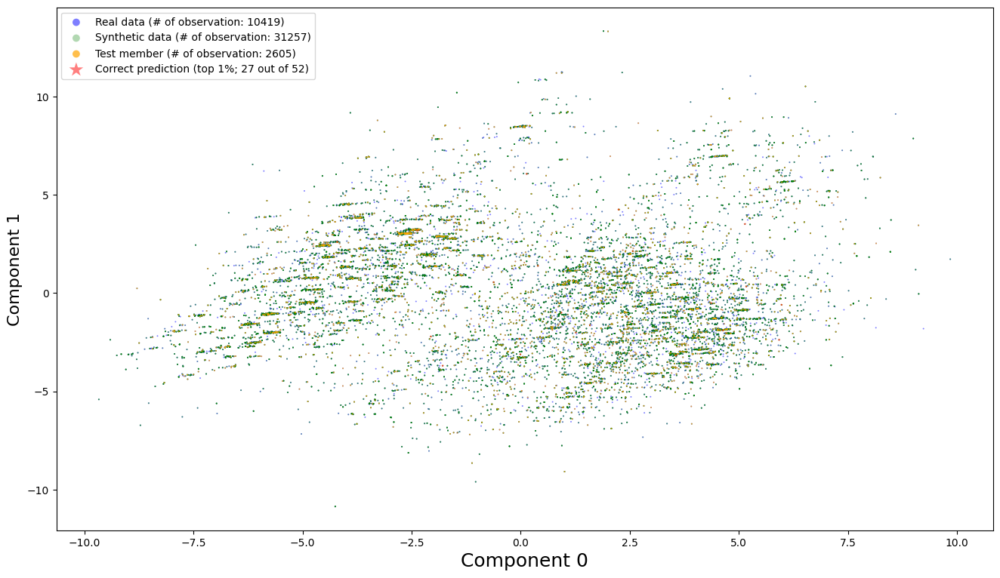

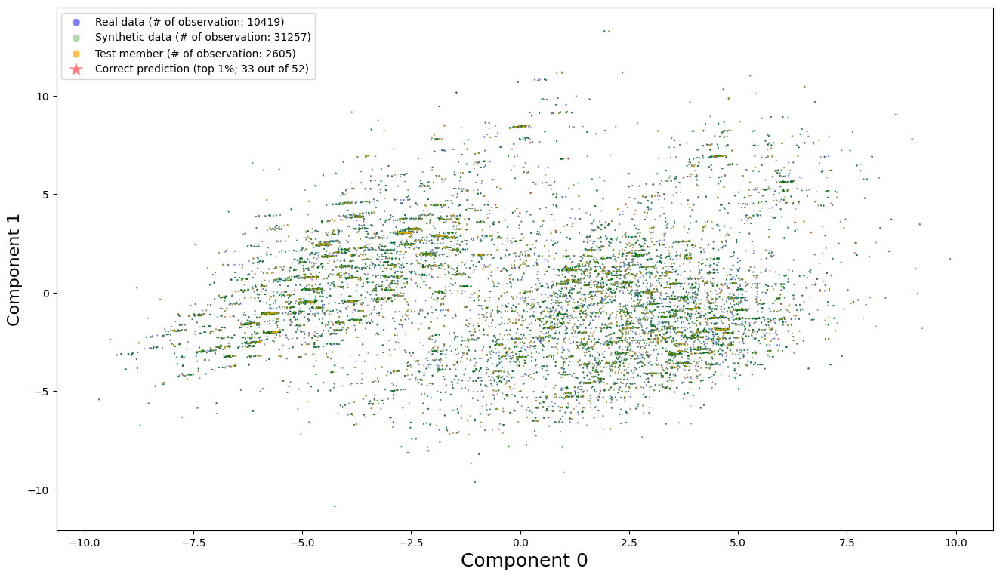

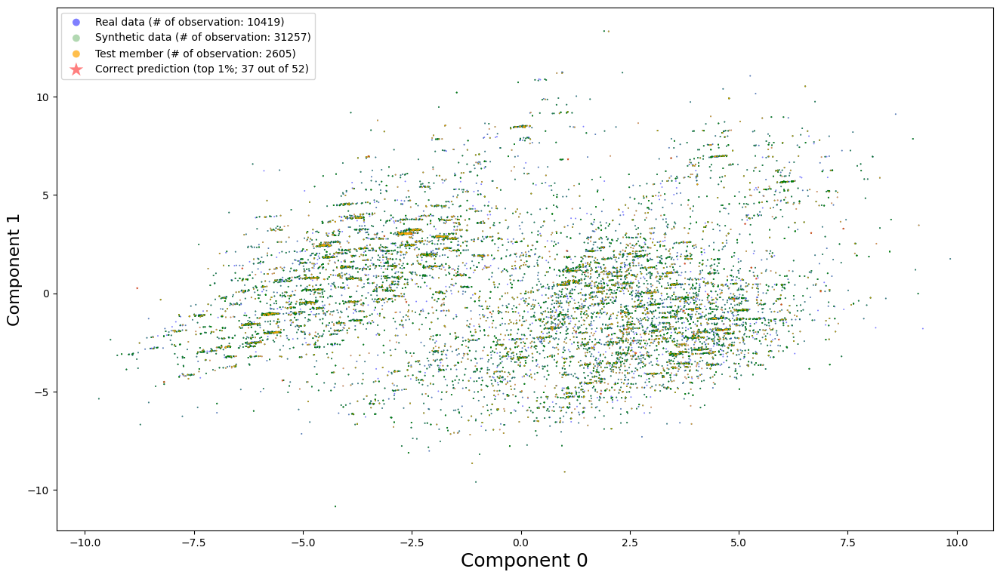

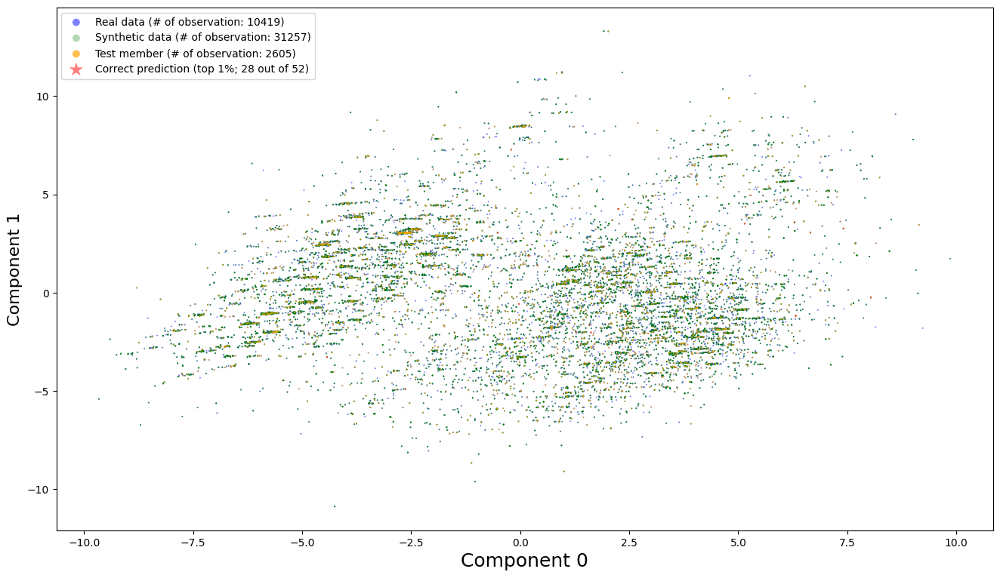

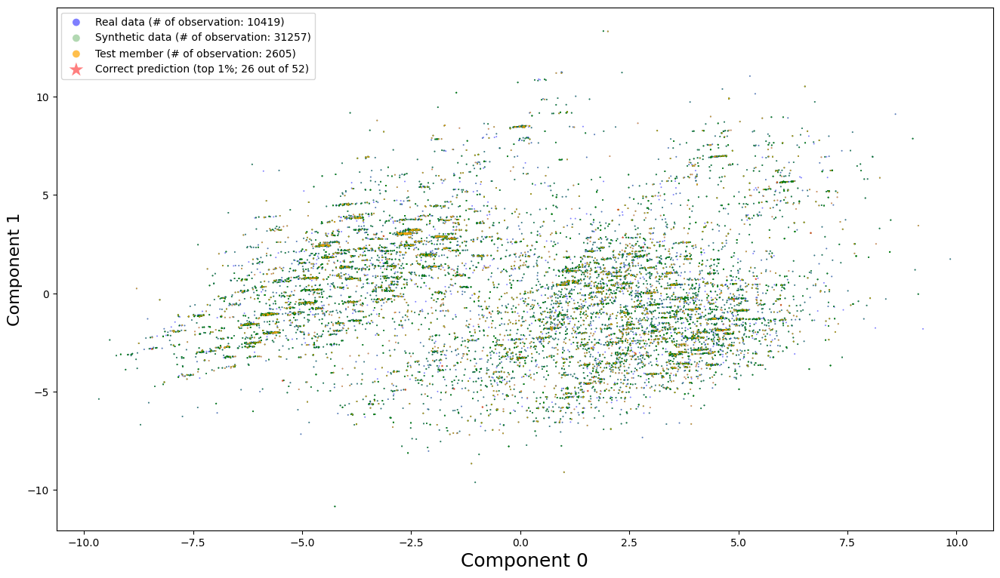

Detector


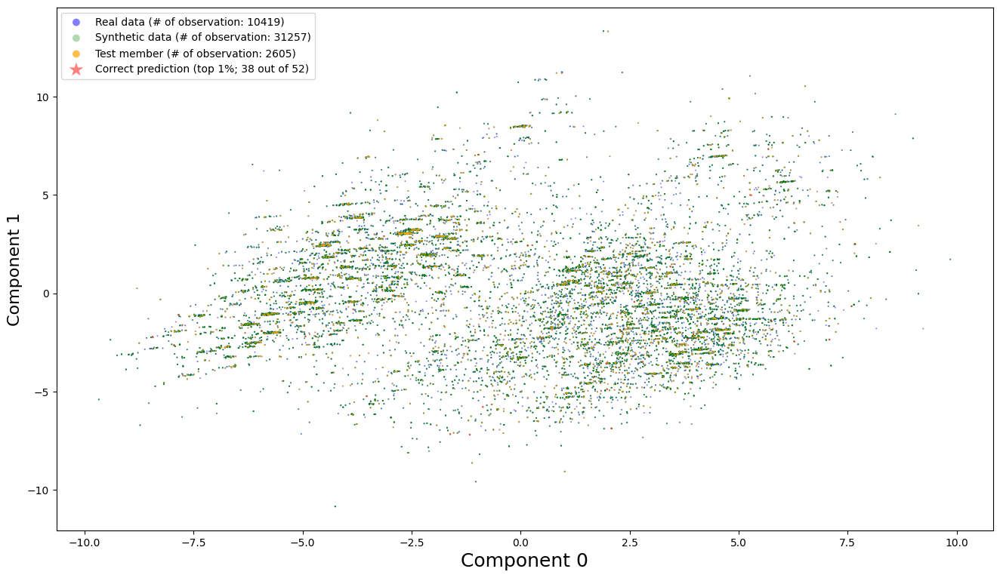

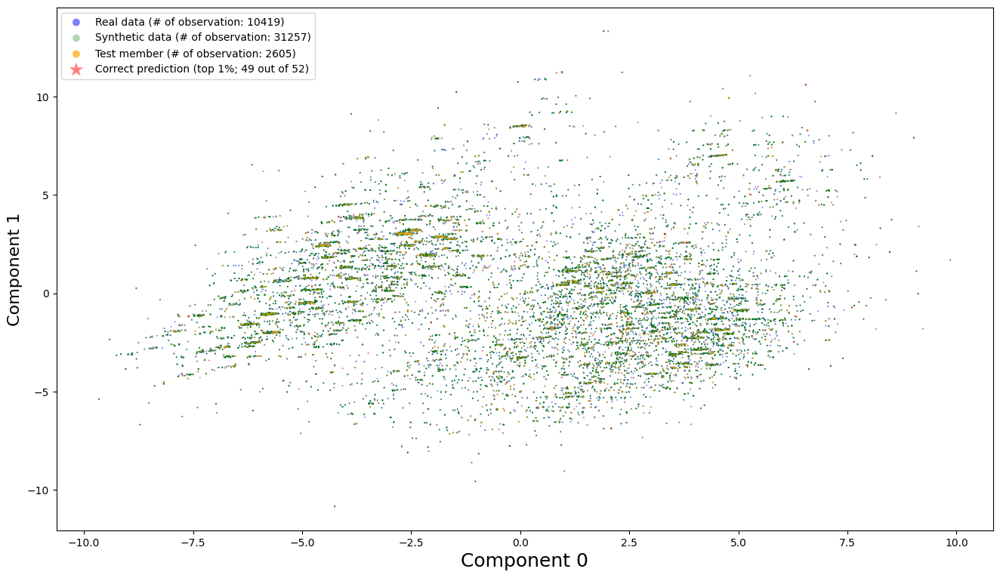

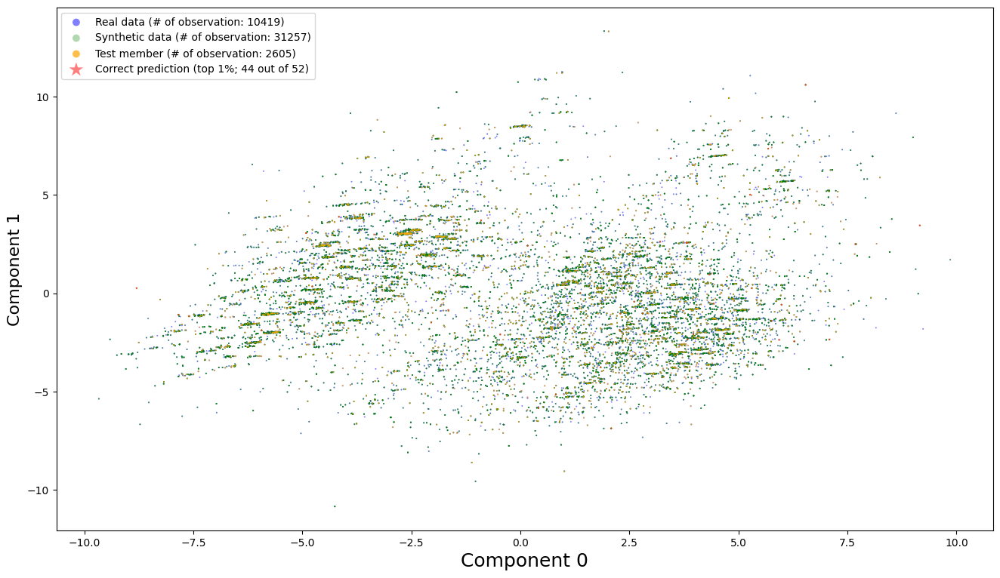

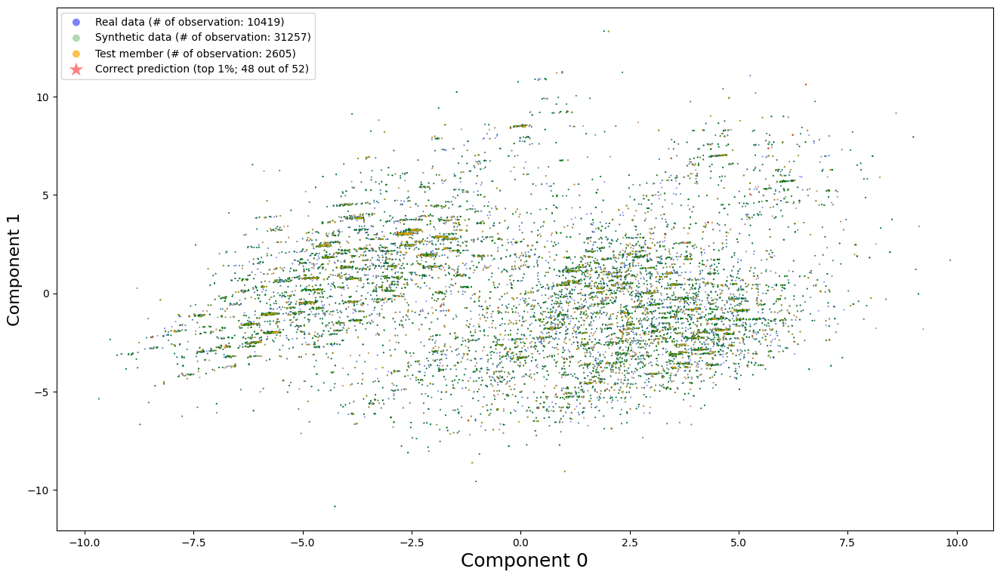

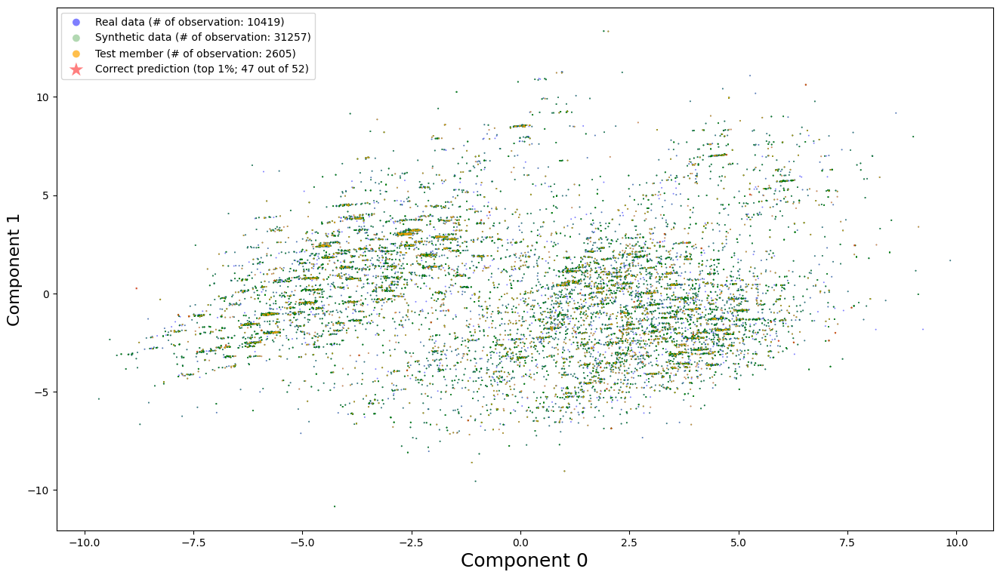

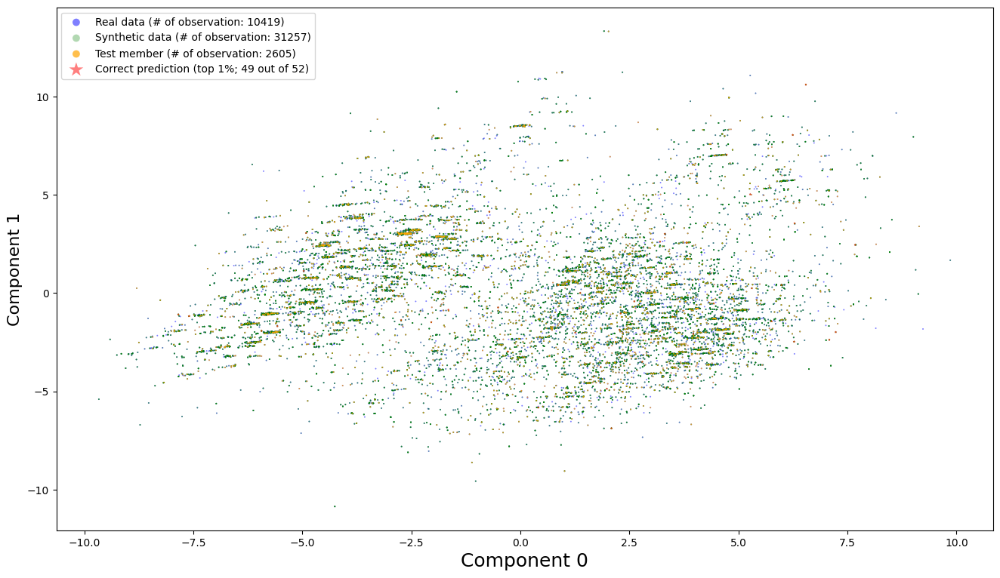

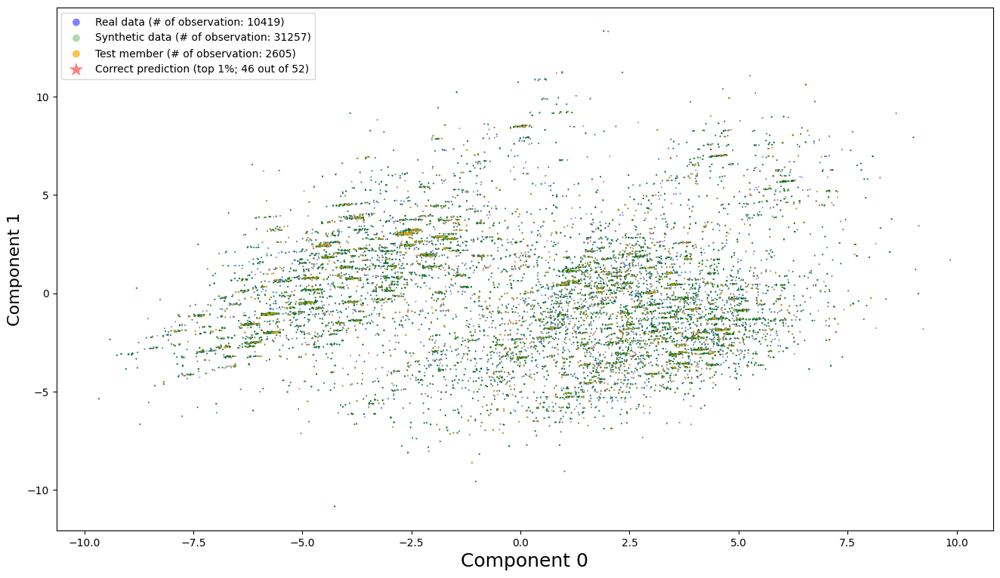

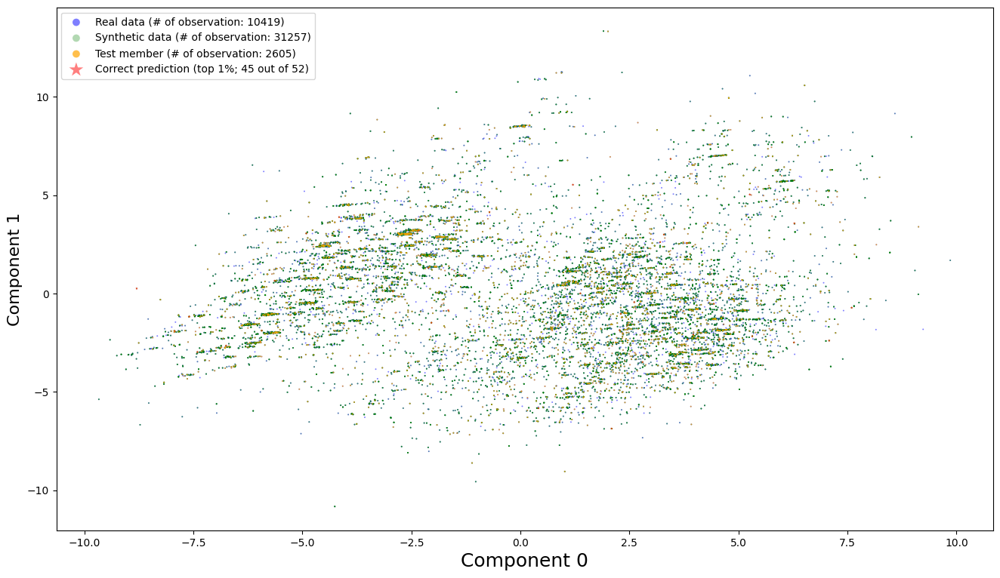

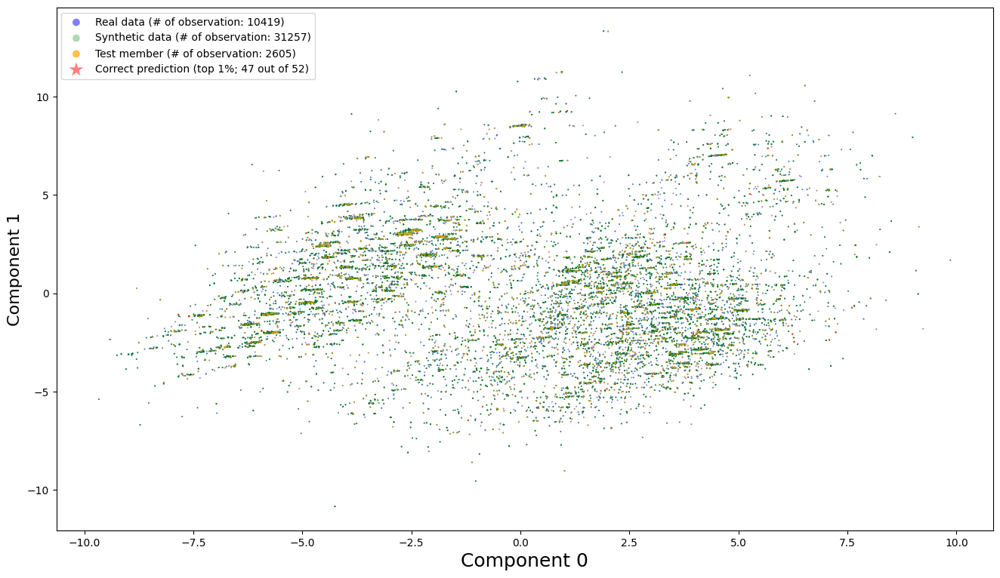

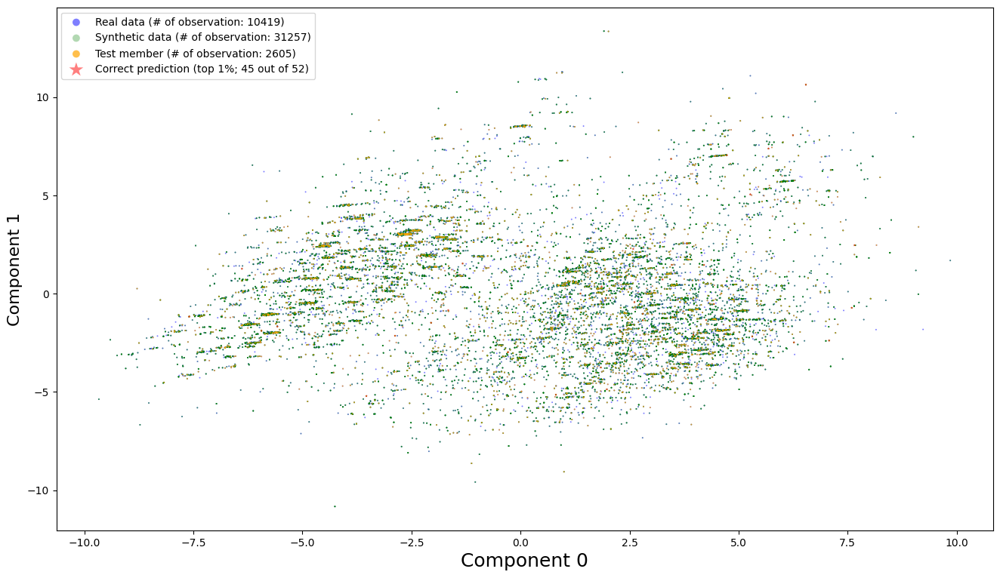

Soft voting


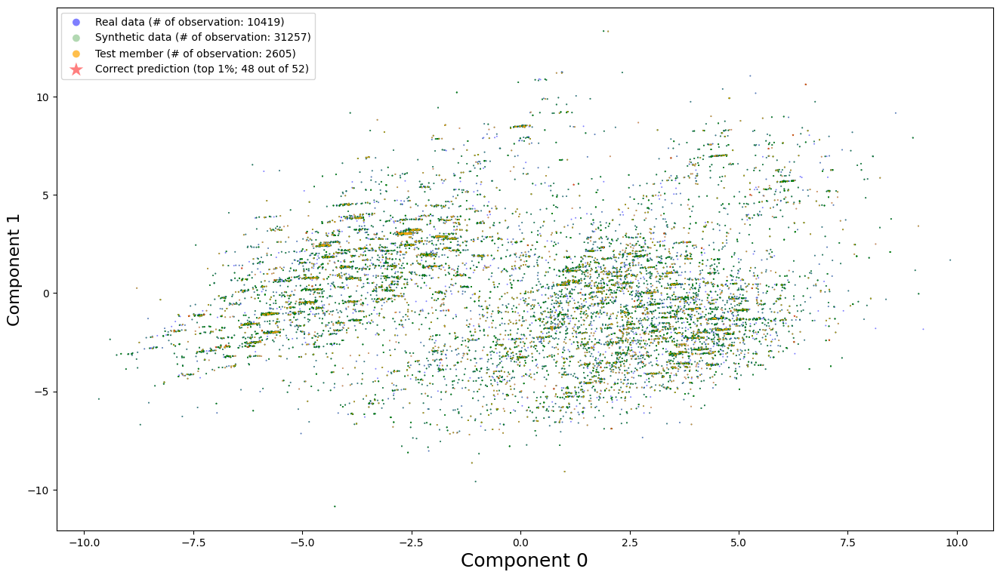

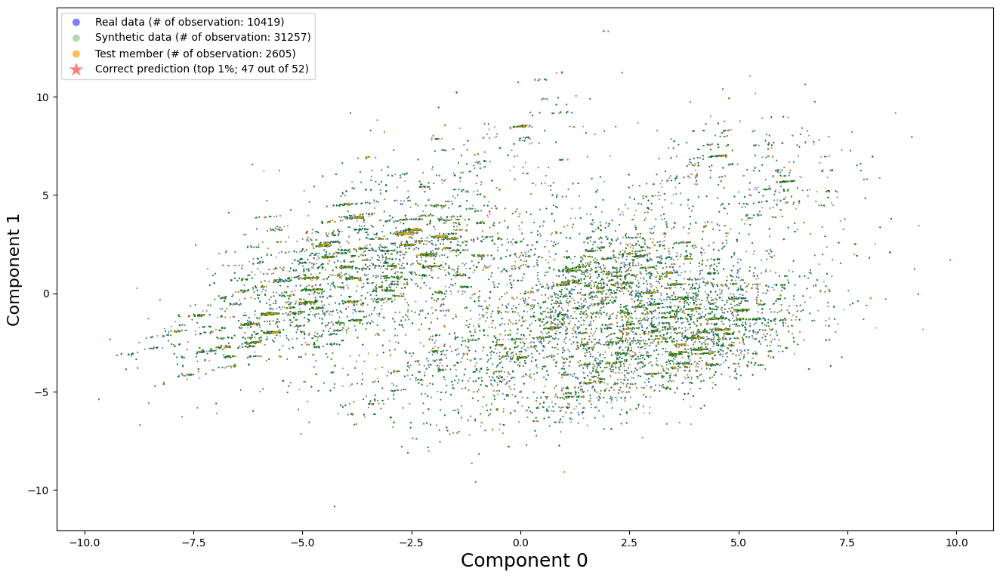

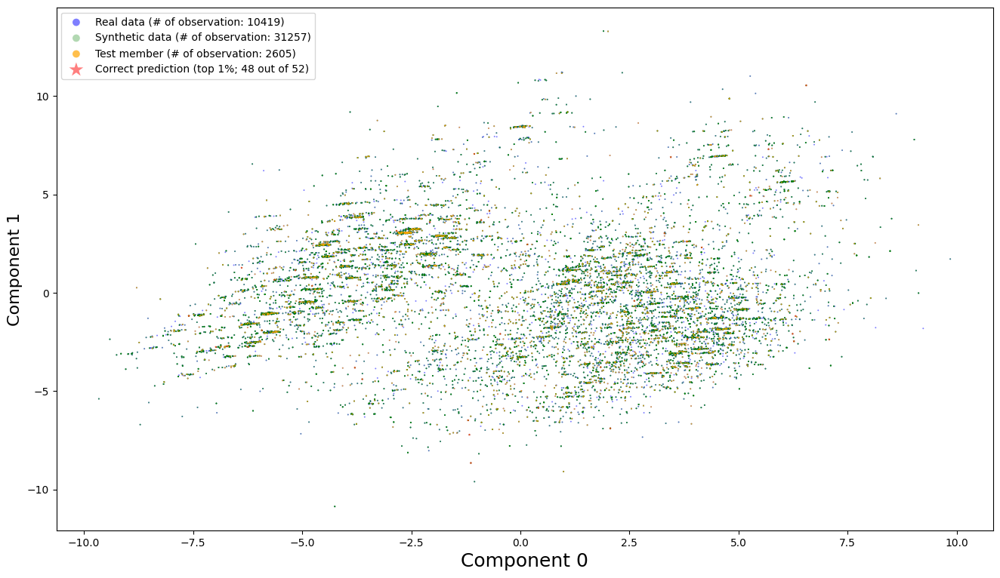

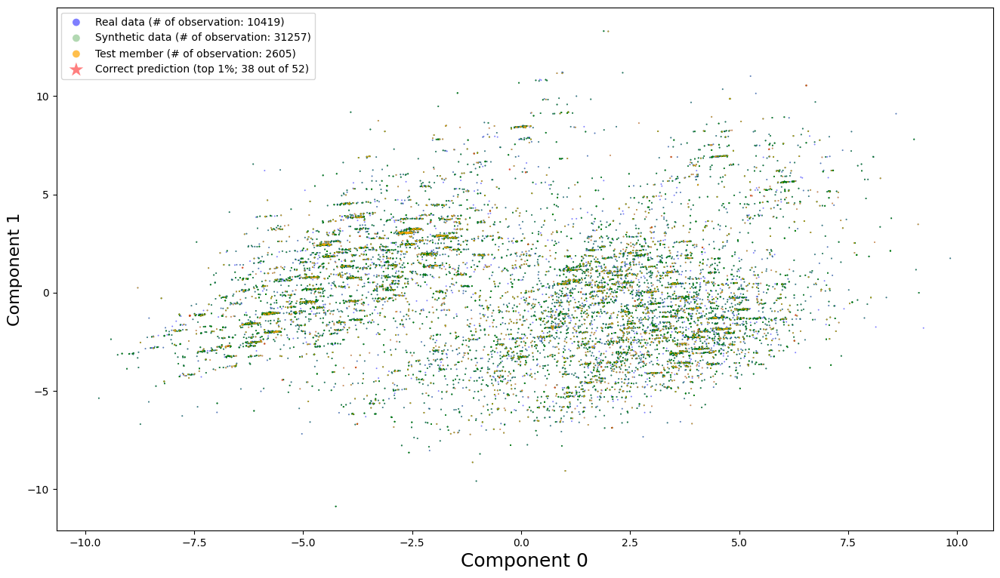

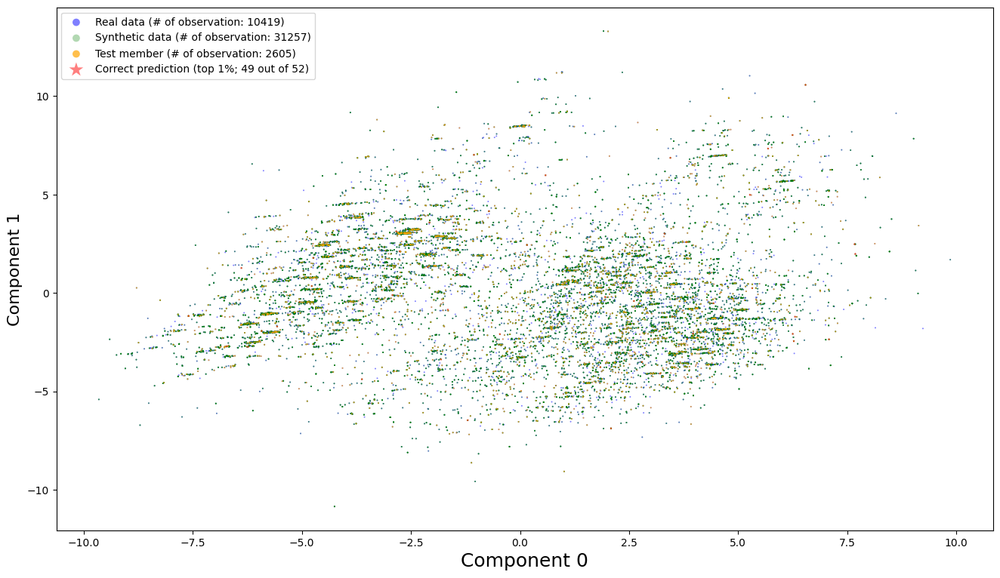

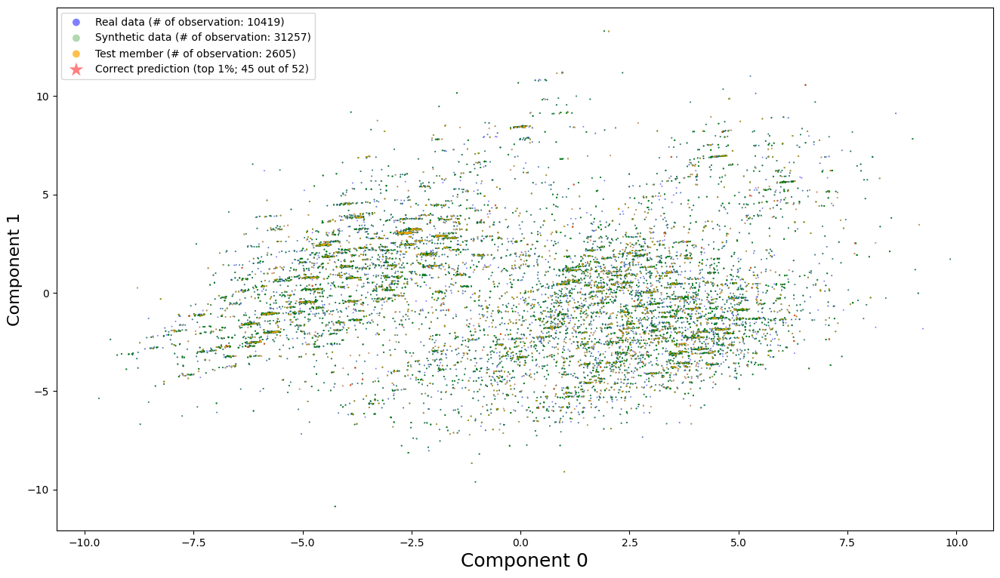

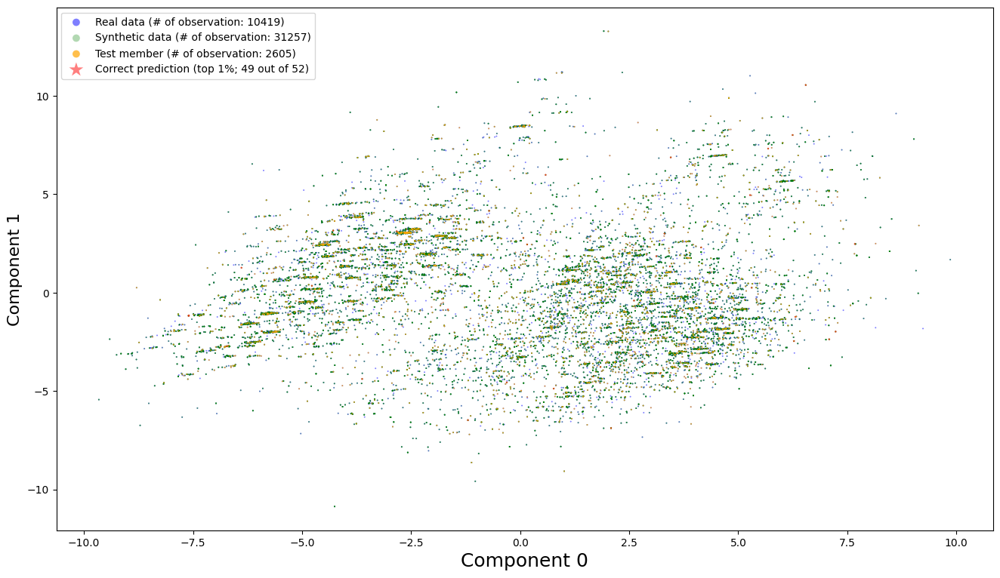

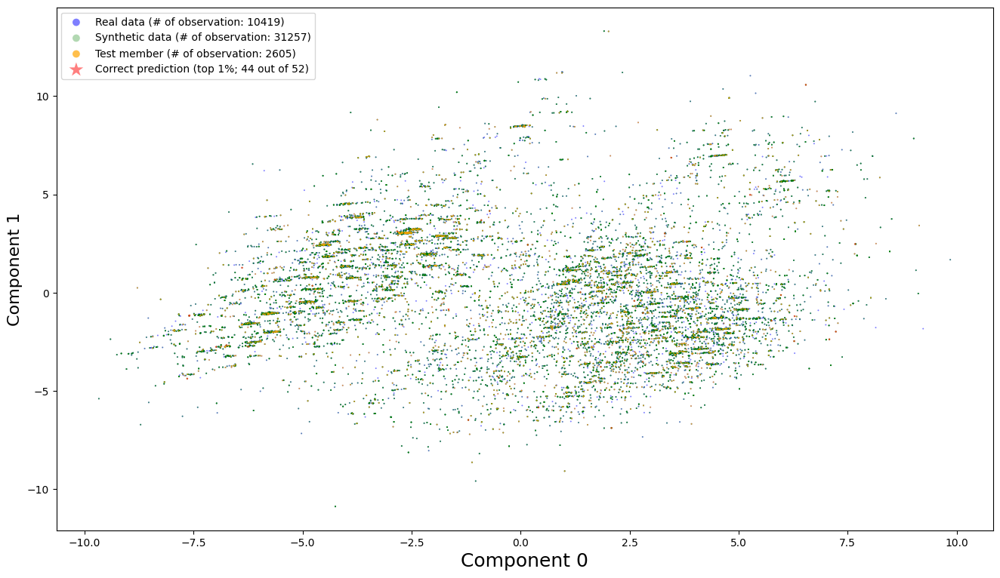

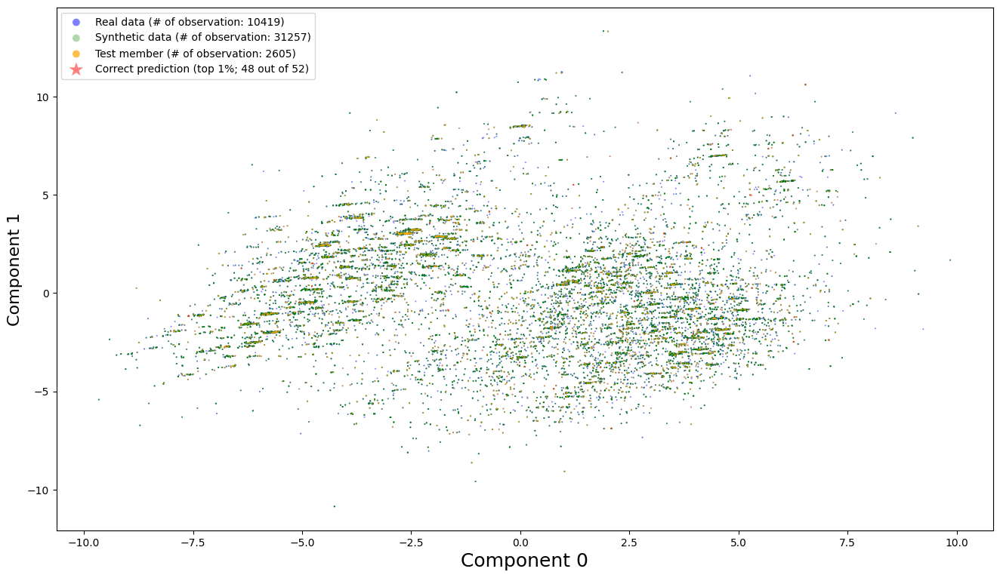

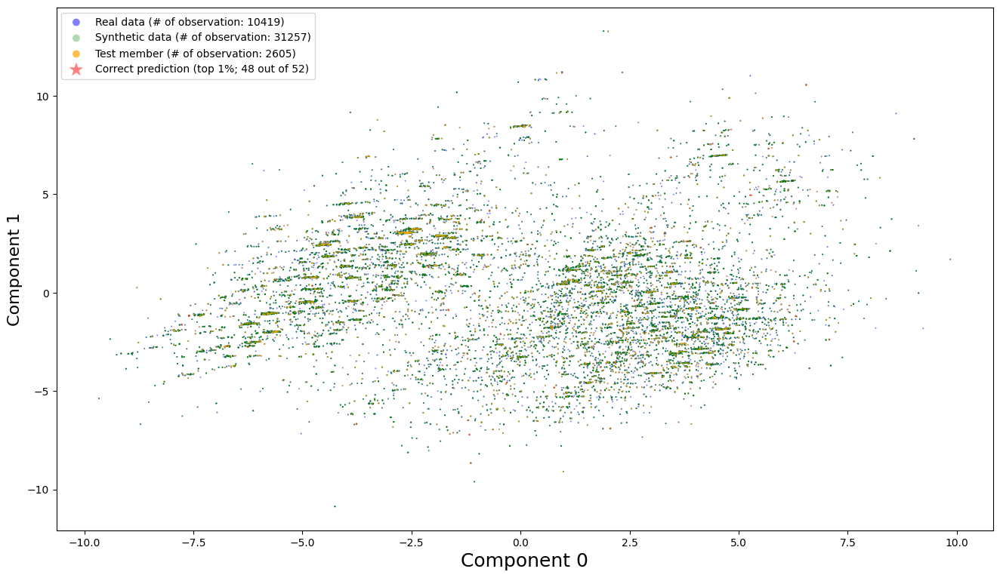

Stacking


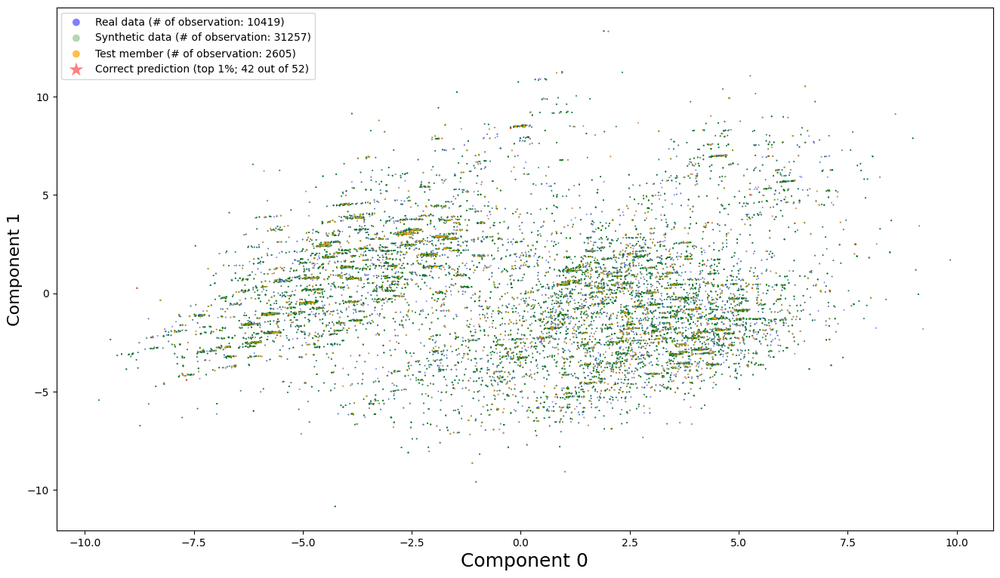

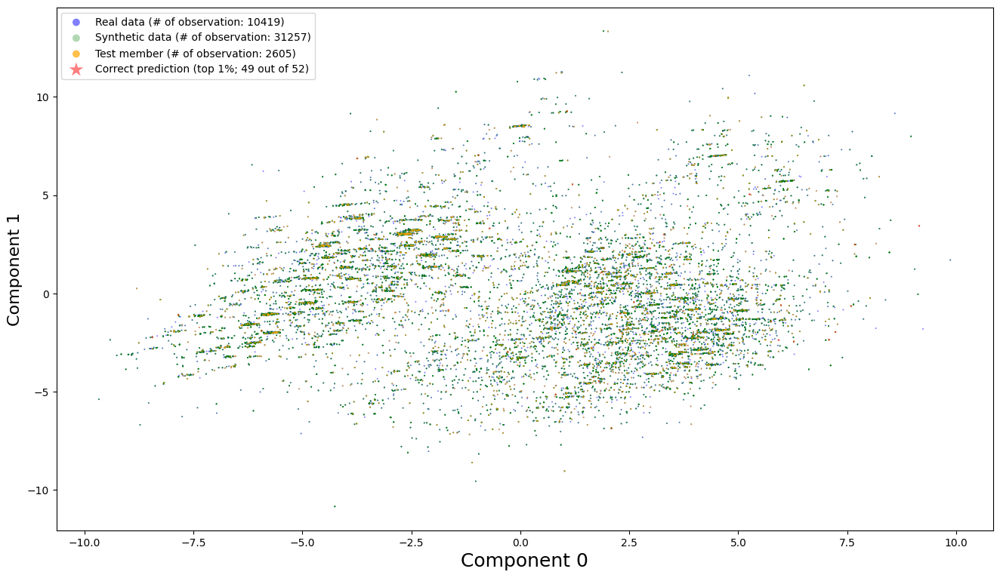

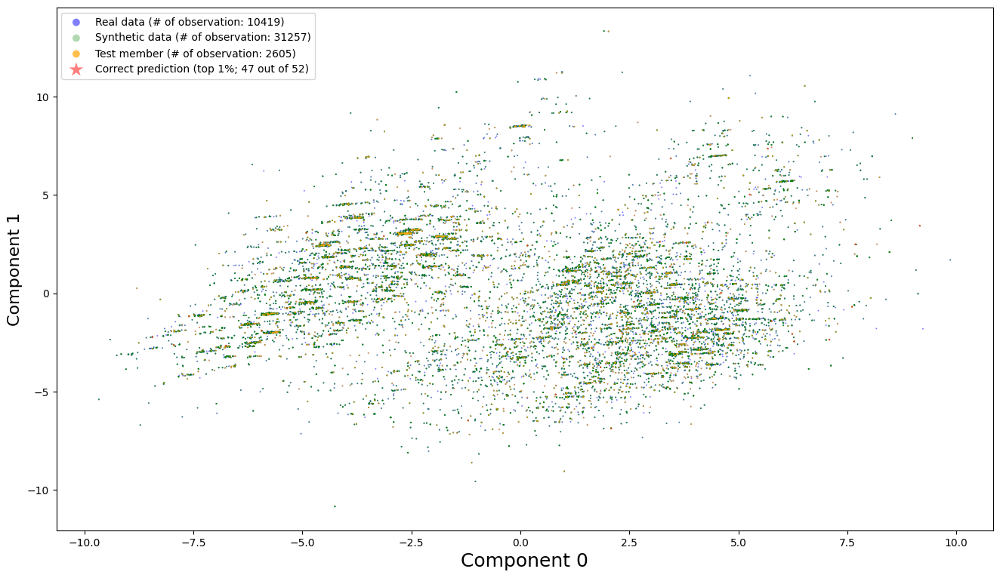

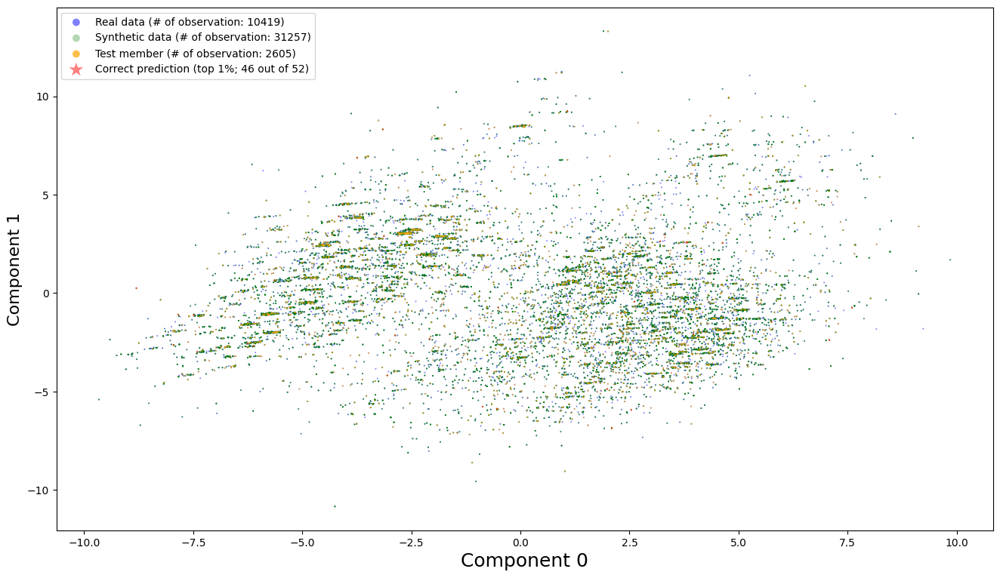

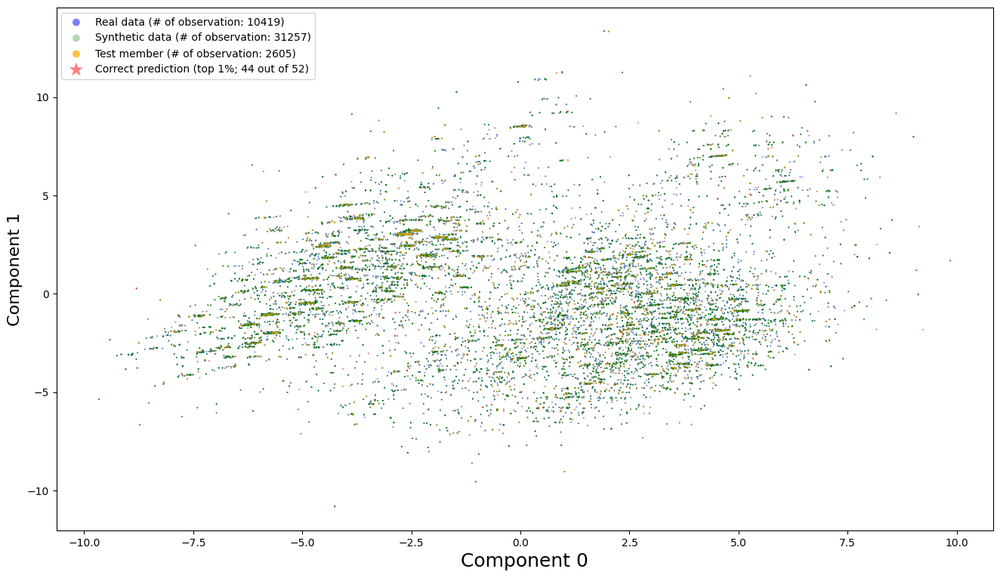

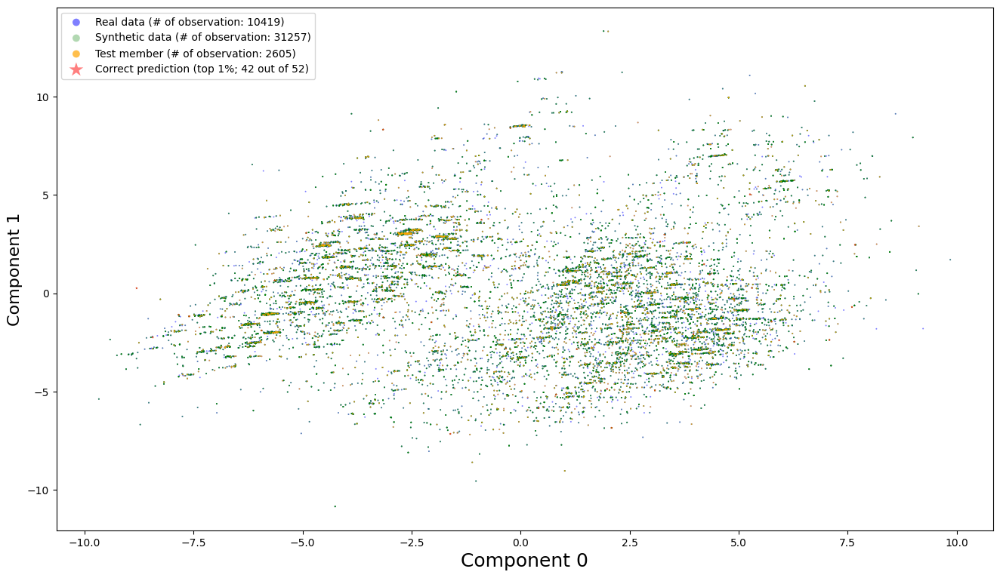

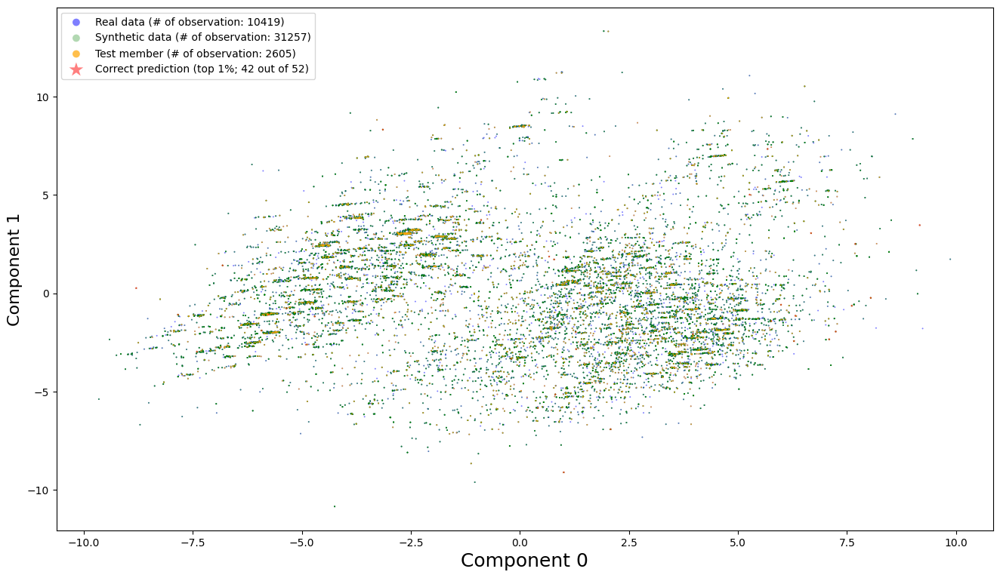

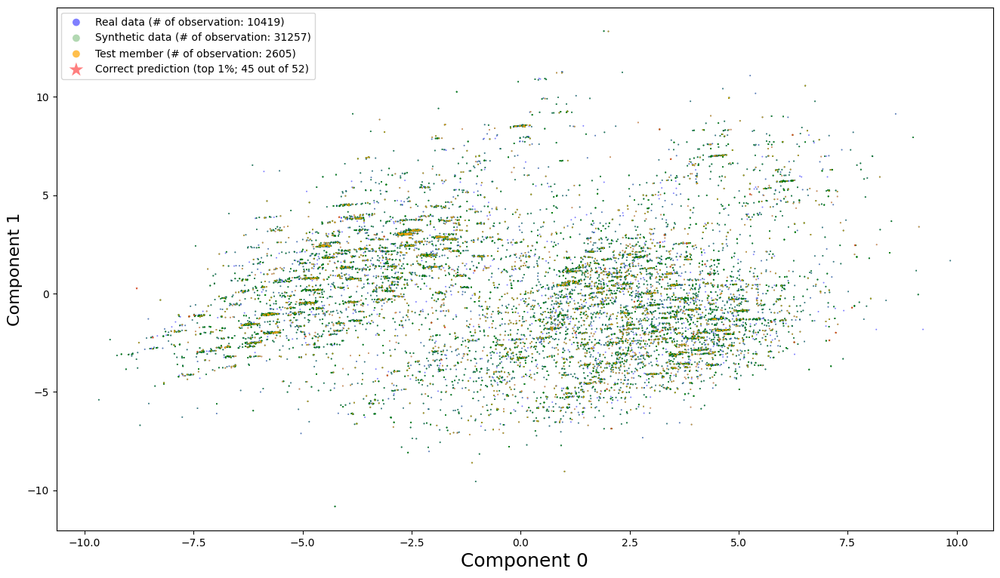

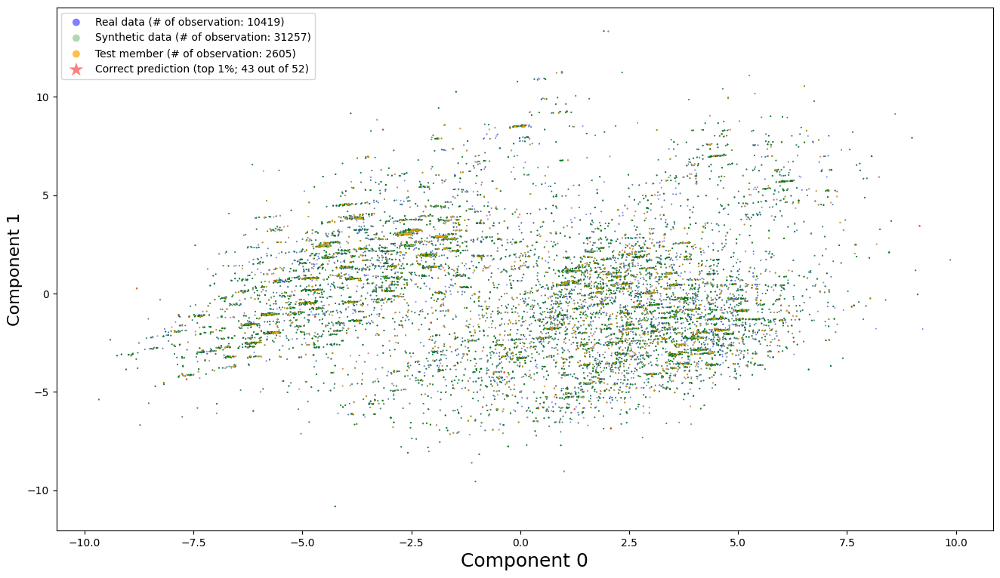

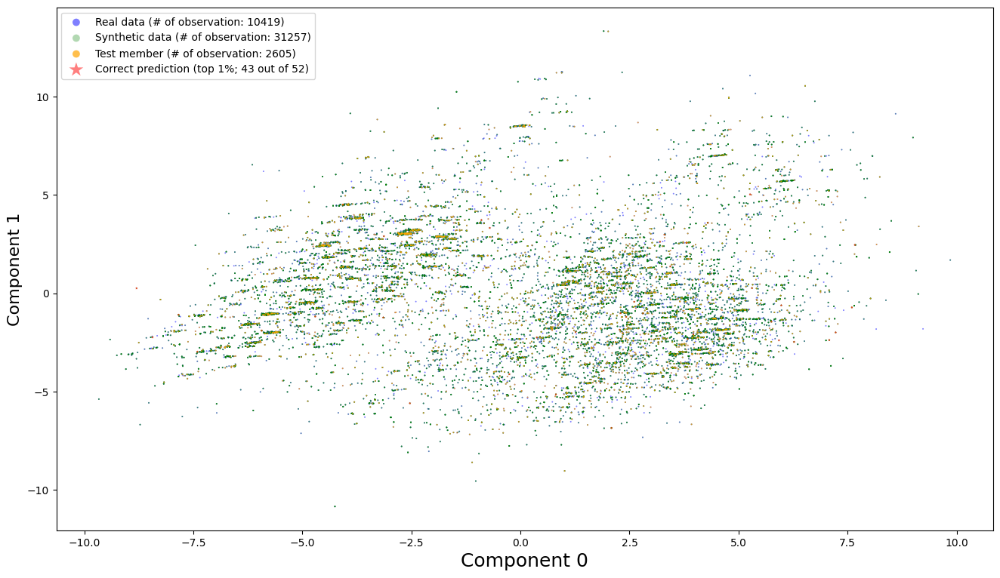

Stacking+


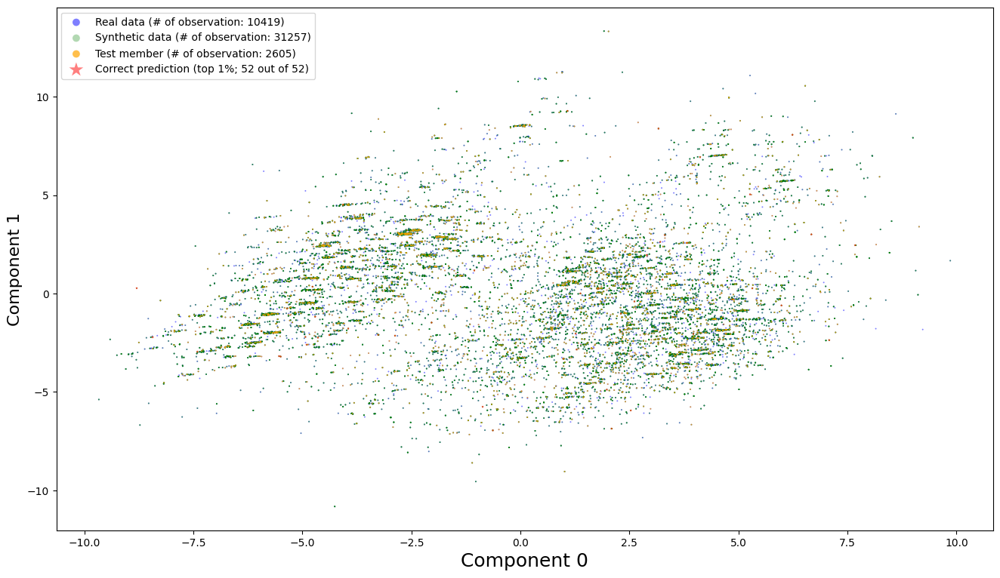

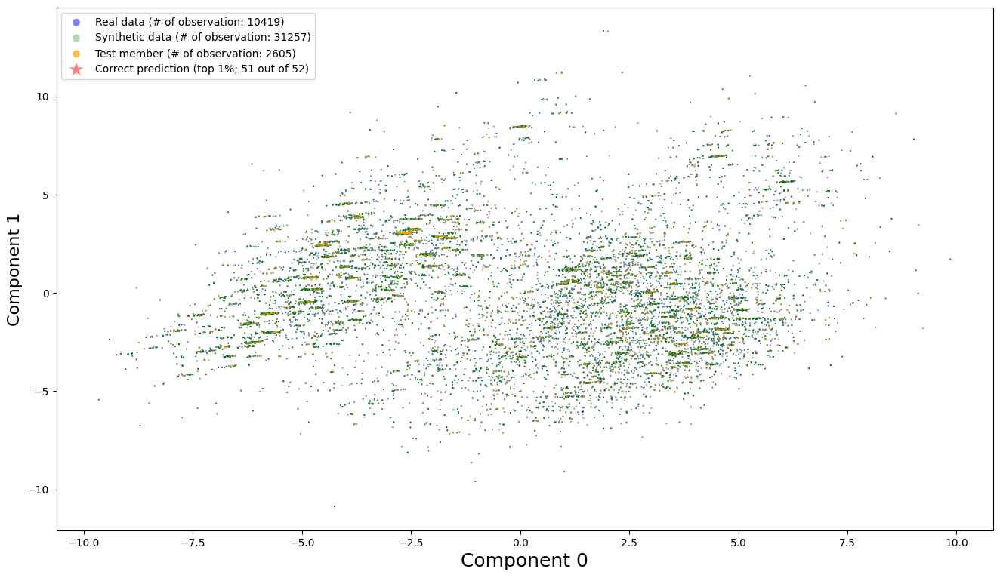

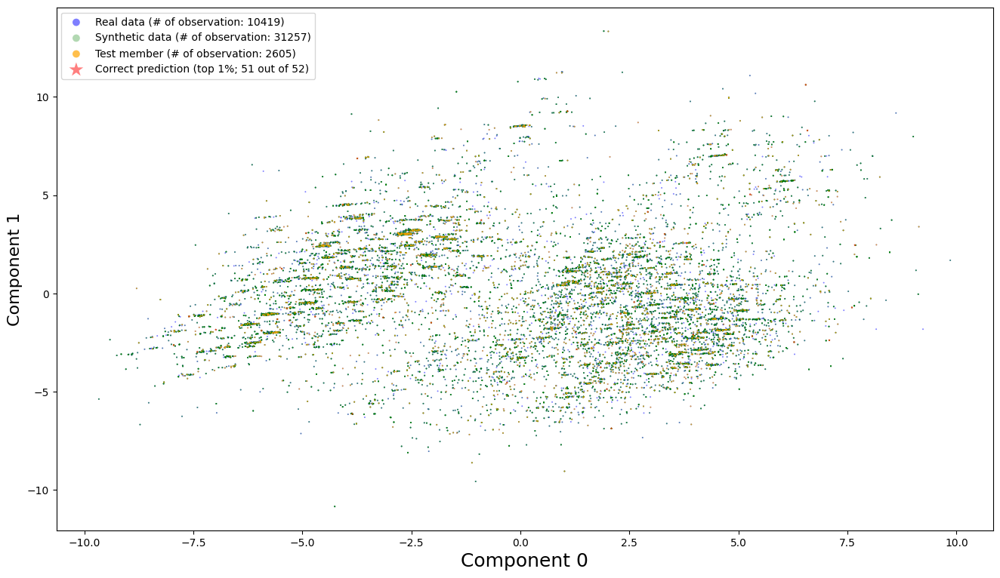

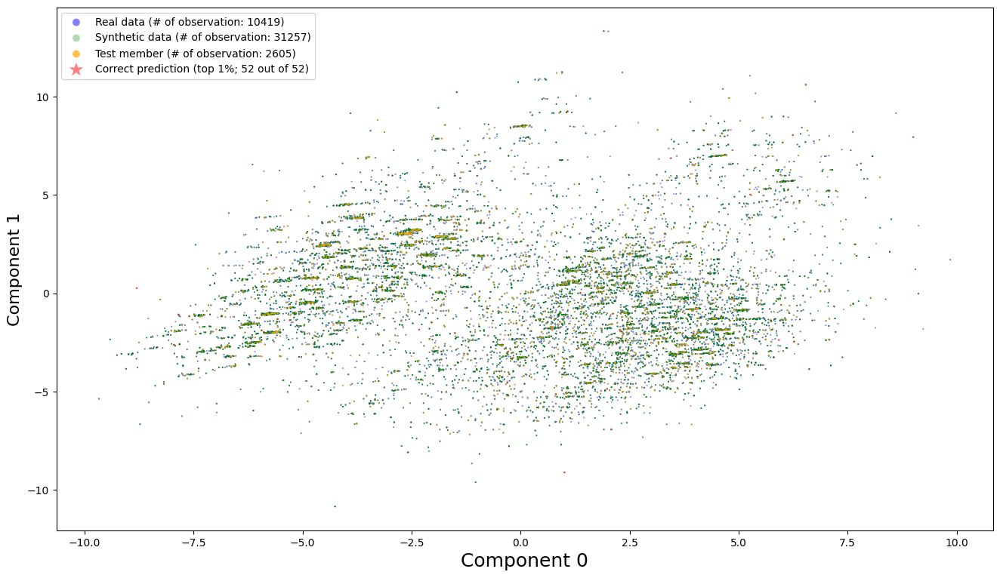

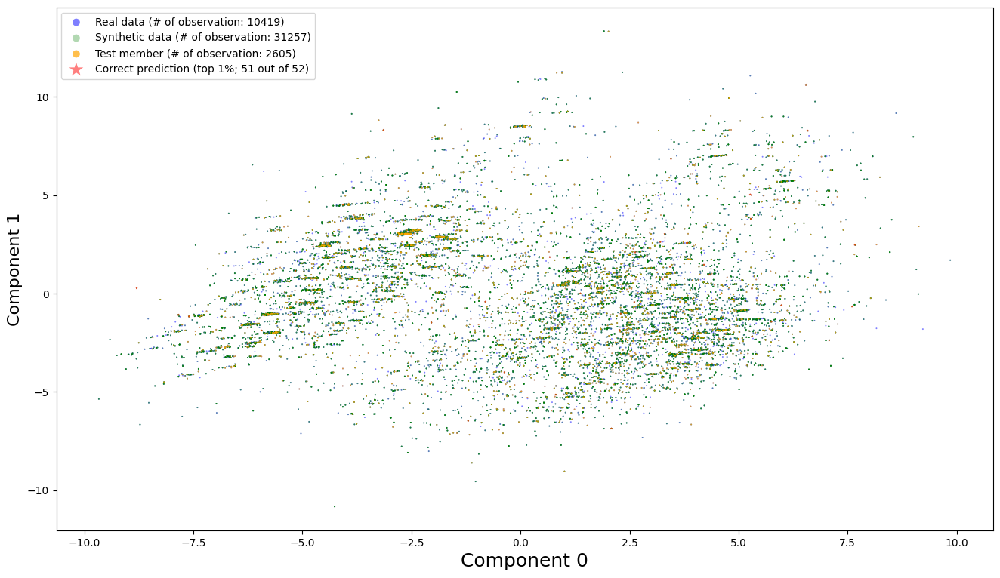

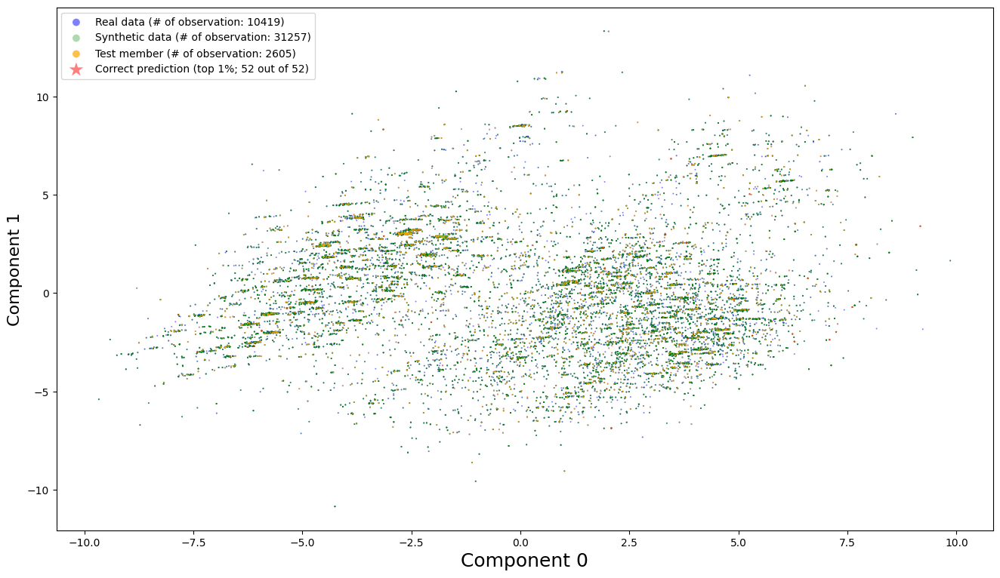

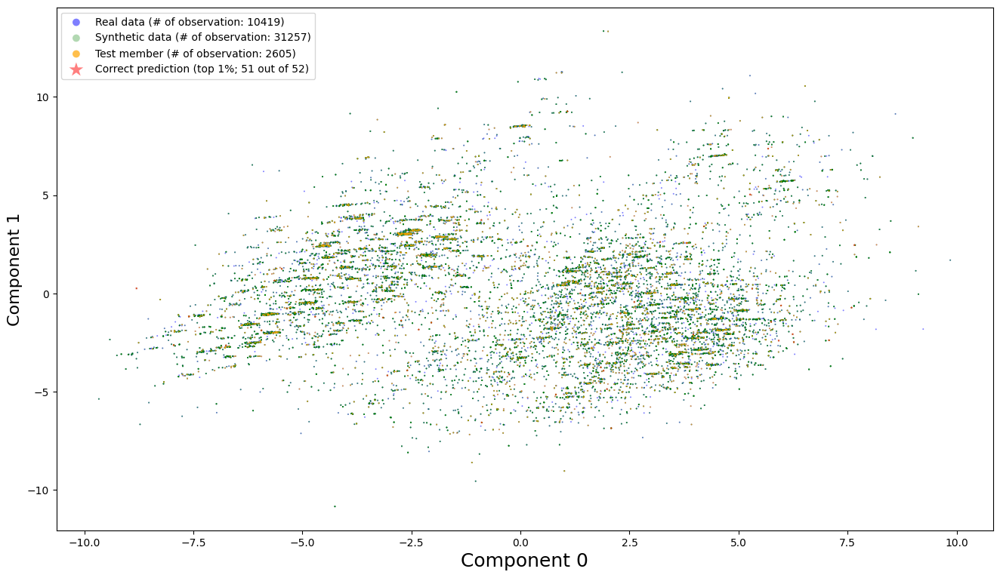

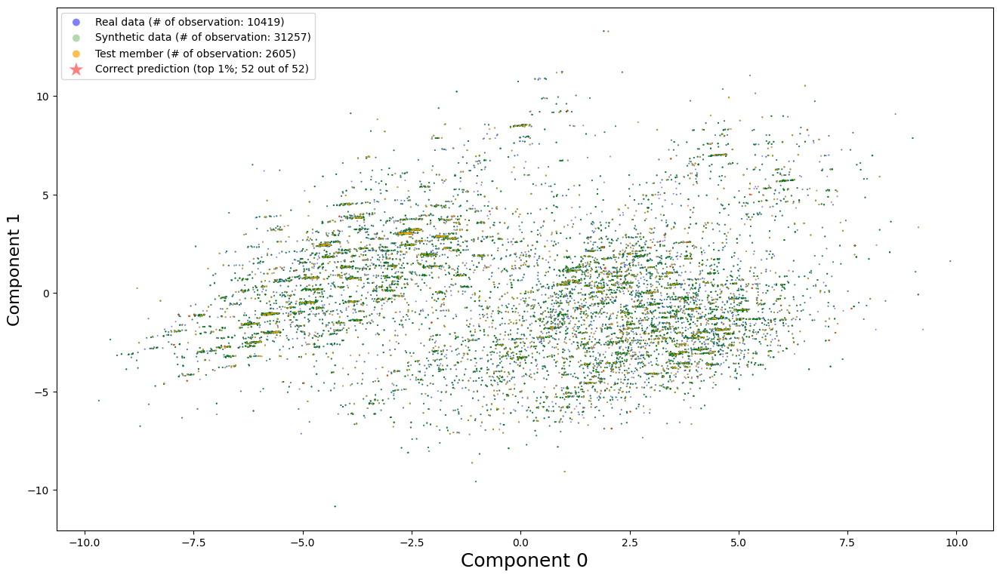

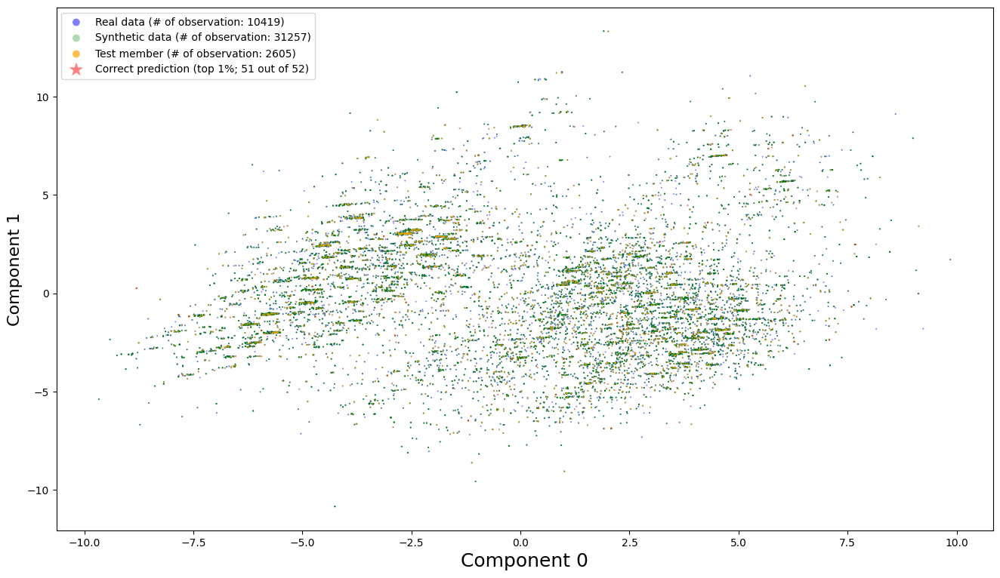

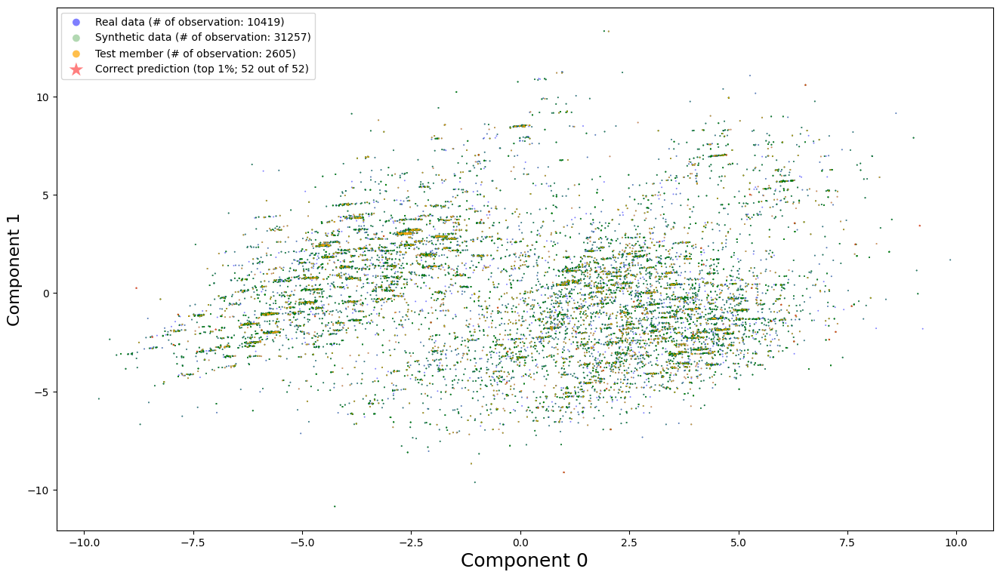

Blending


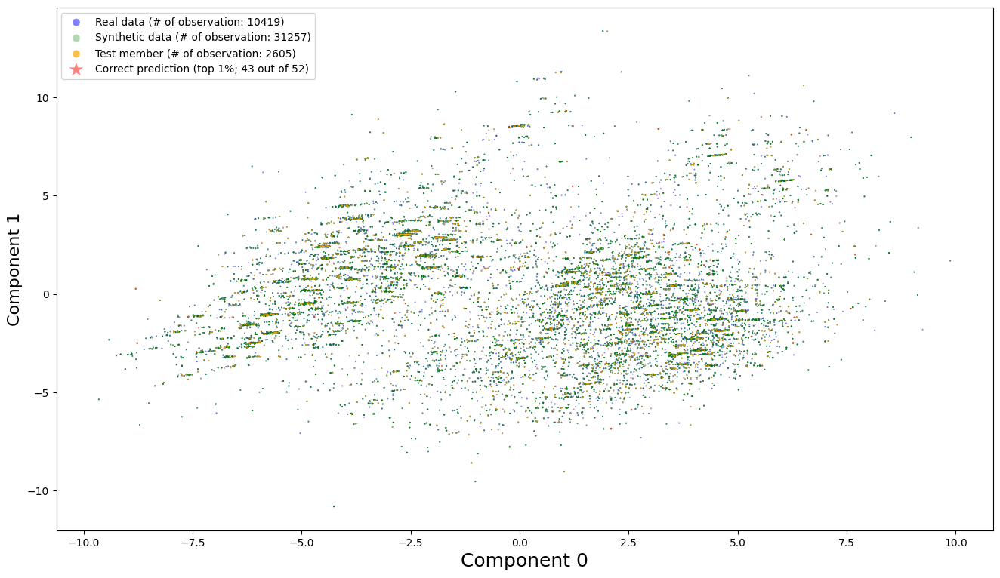

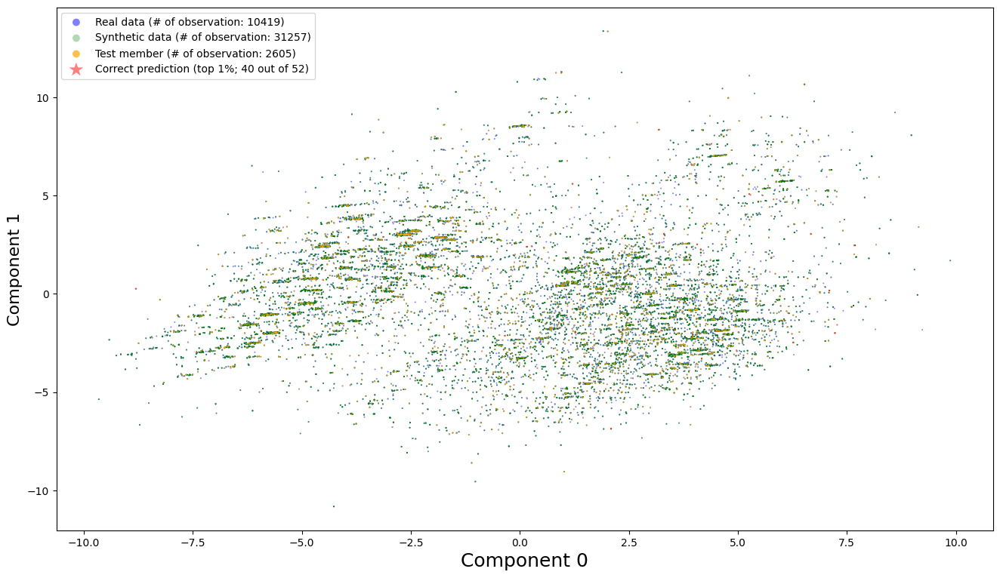

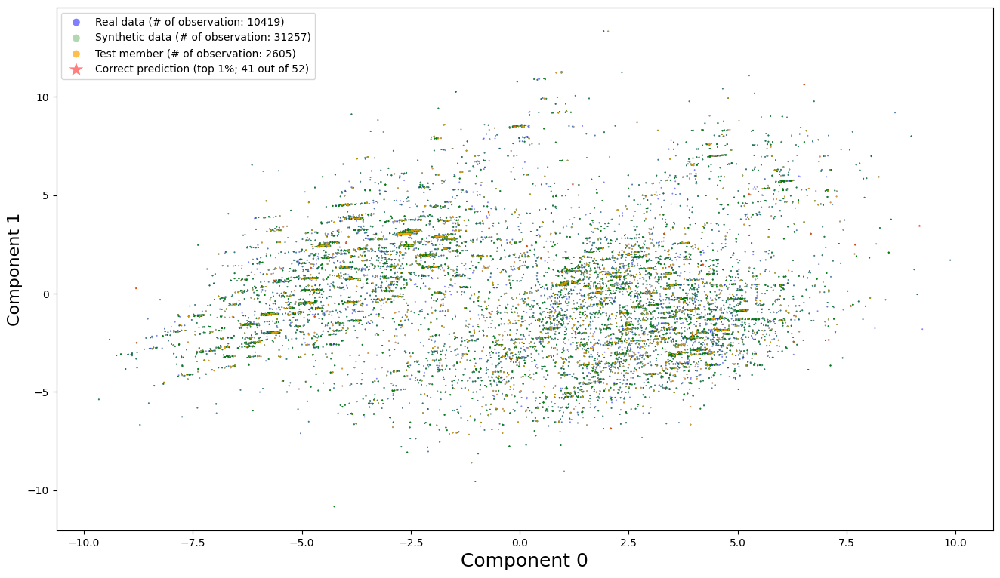

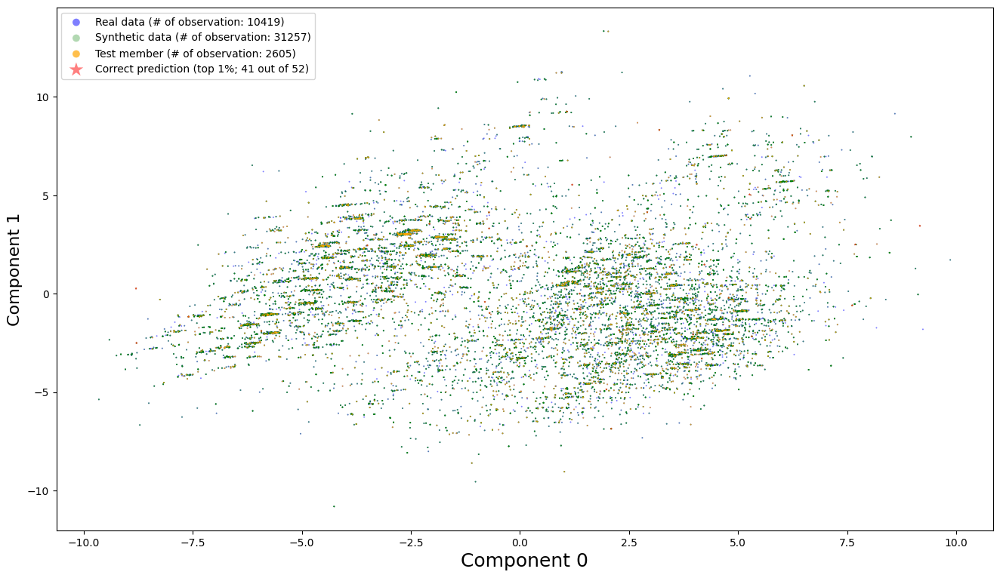

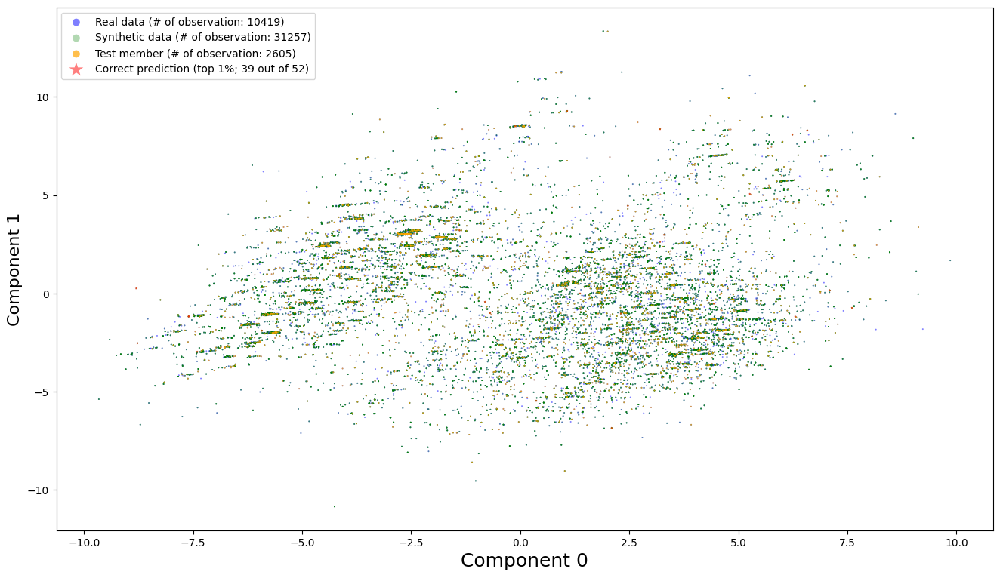

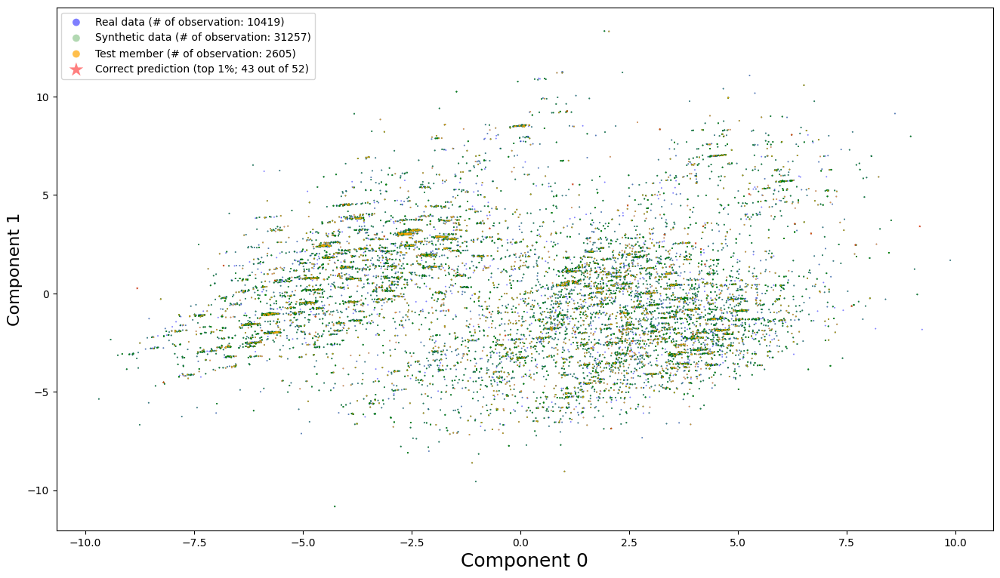

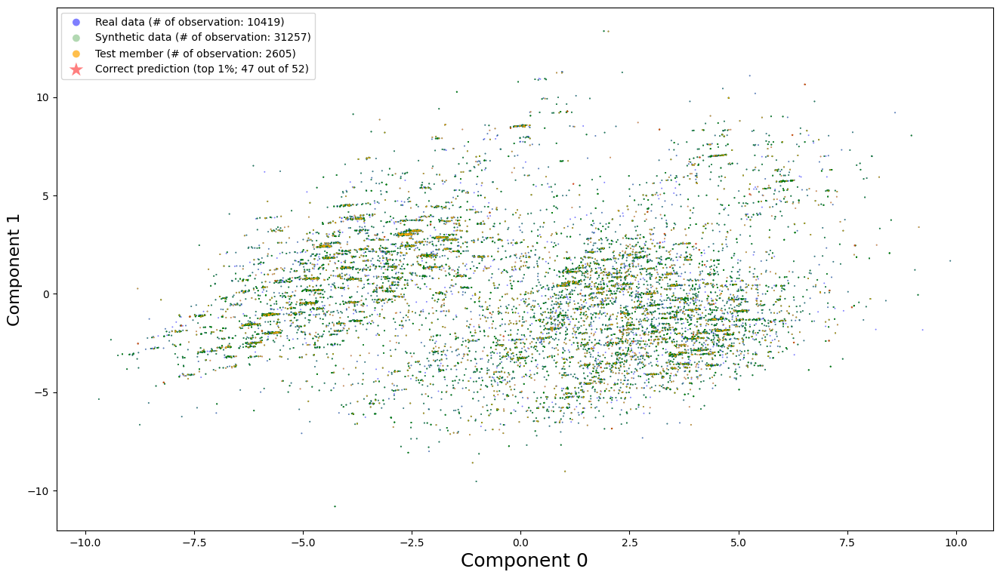

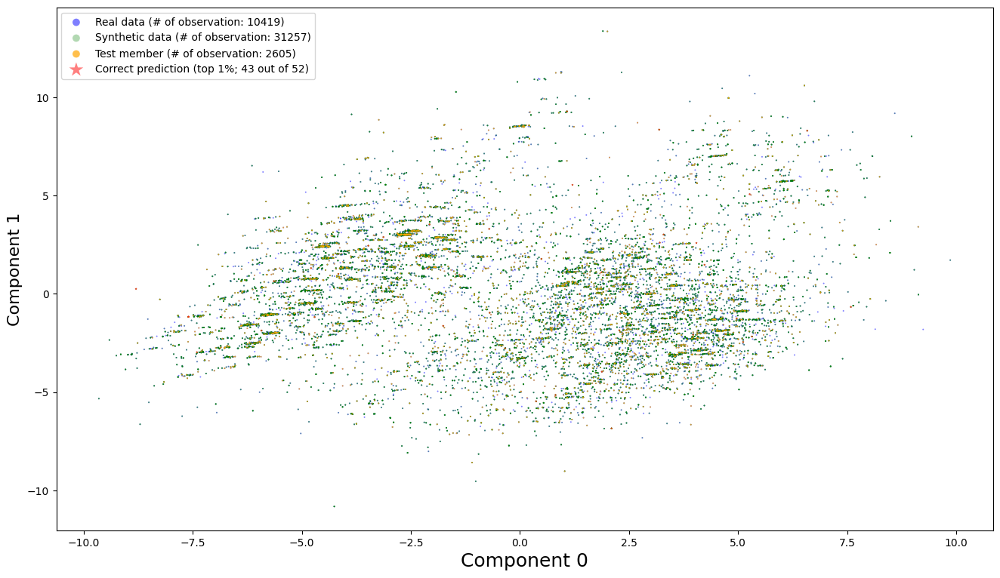

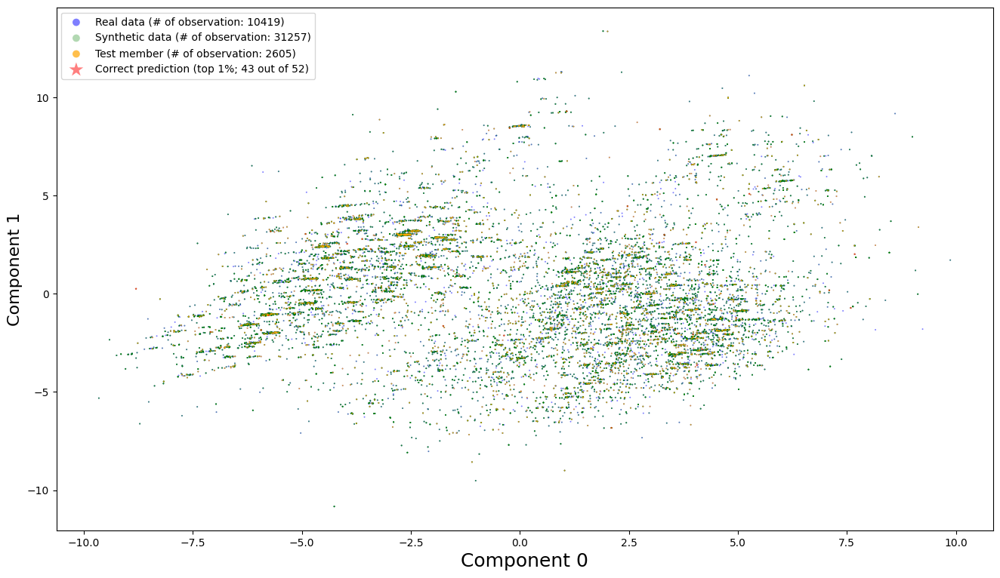

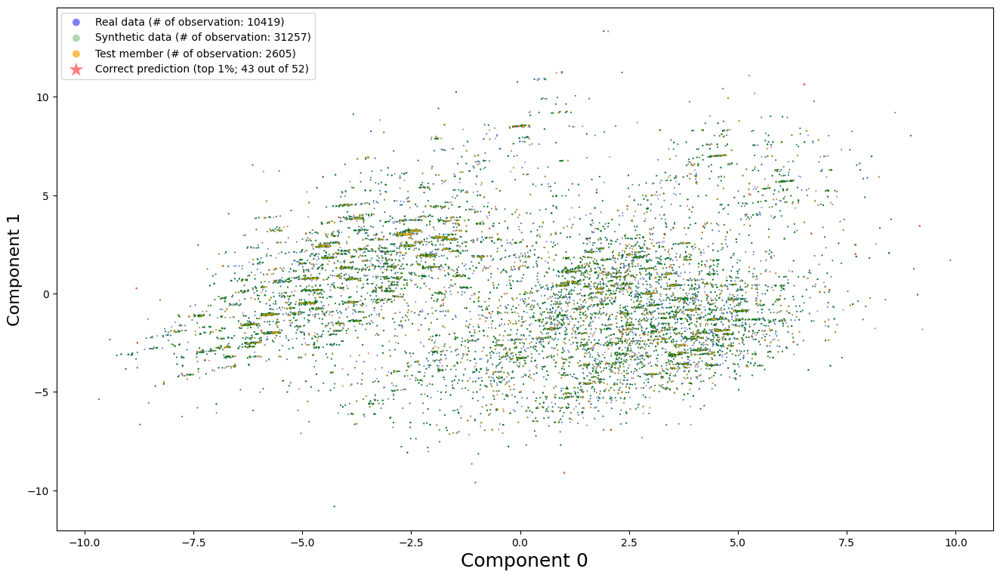

Blending+


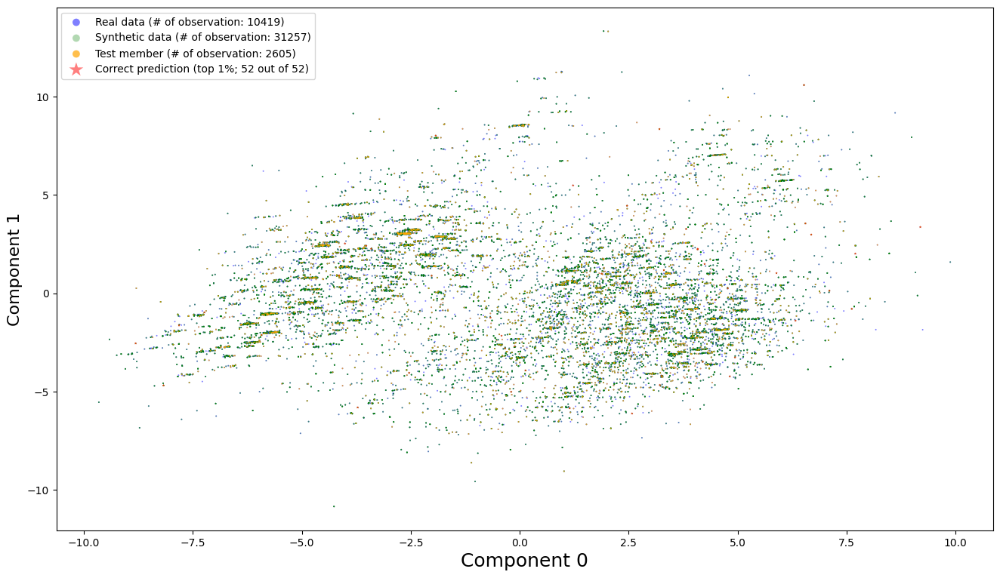

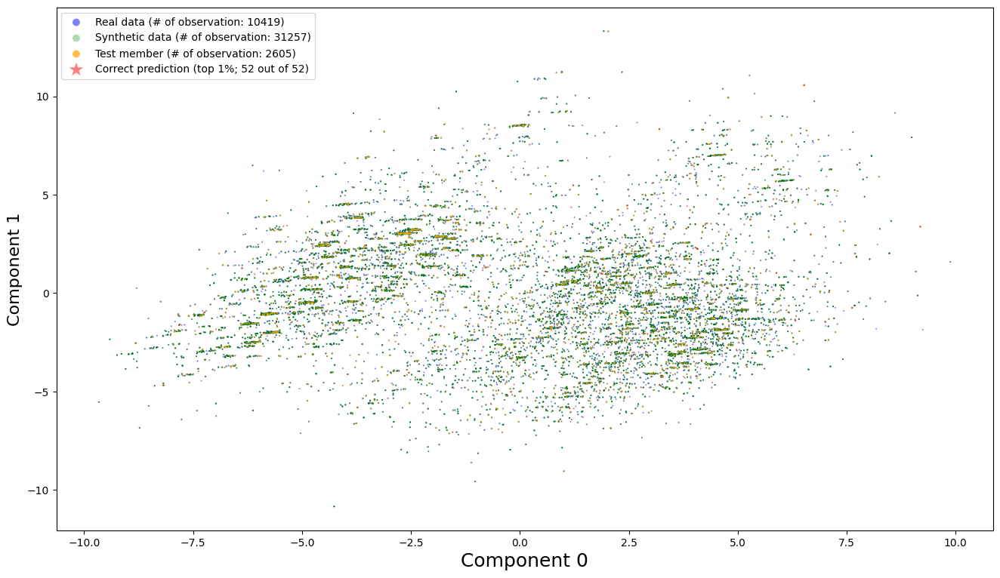

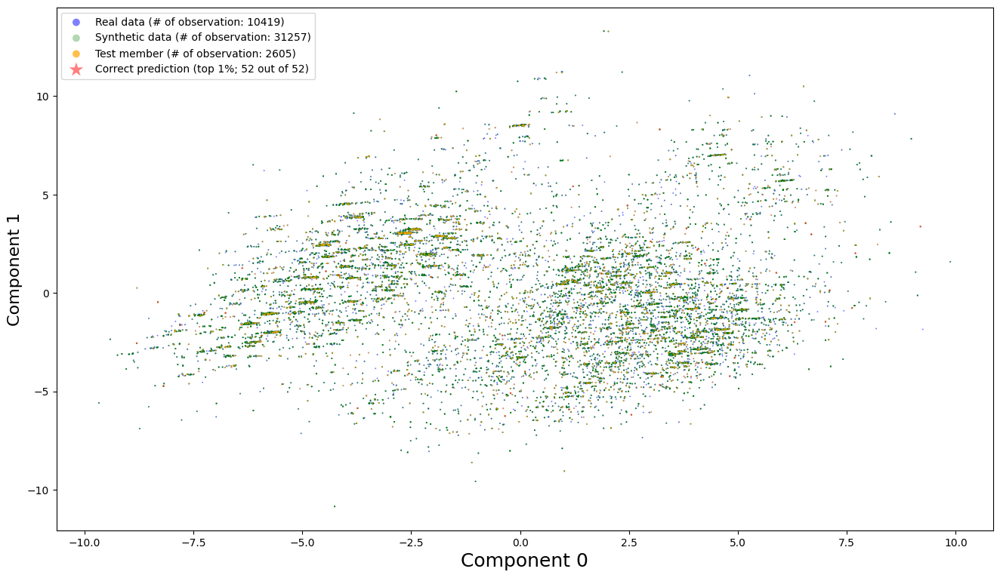

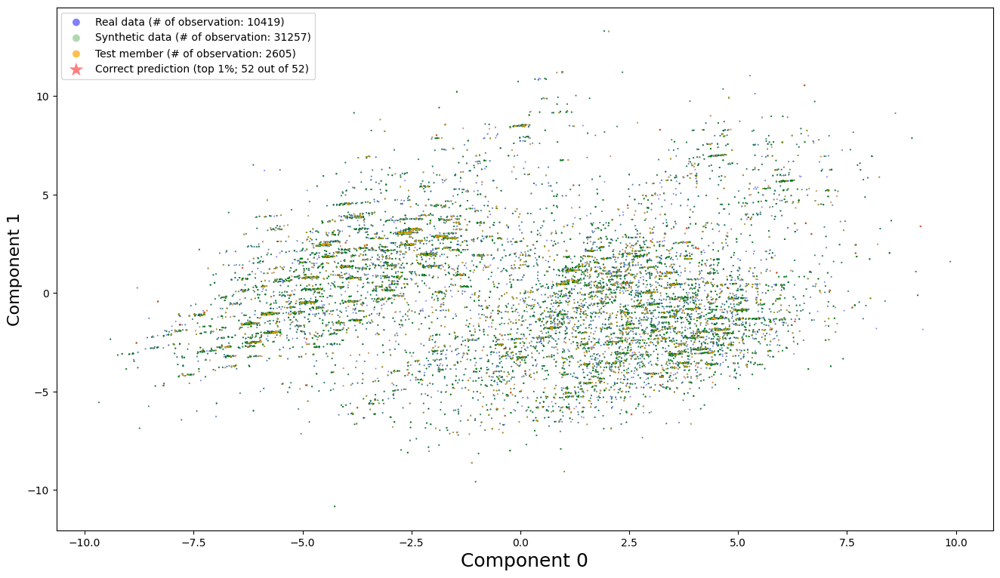

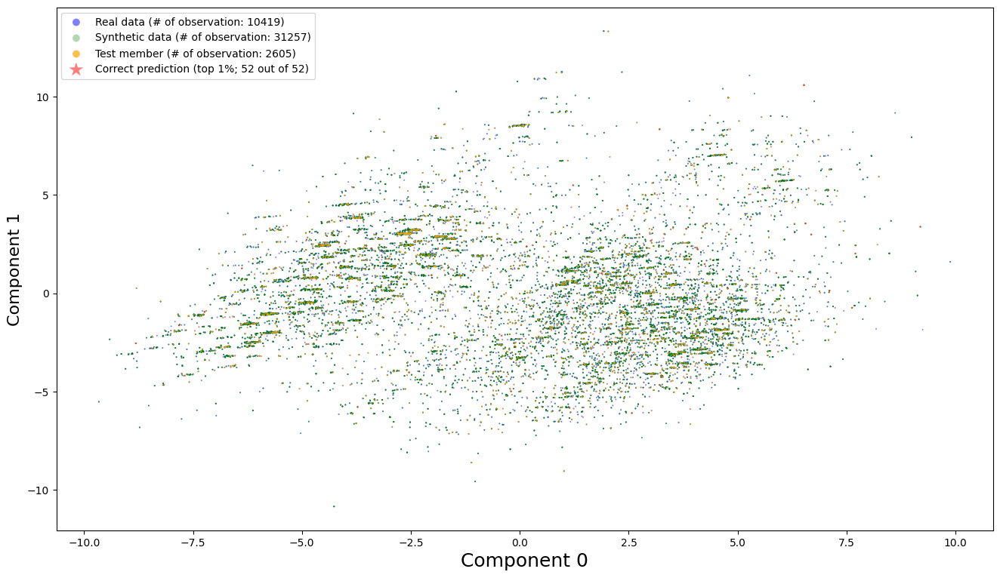

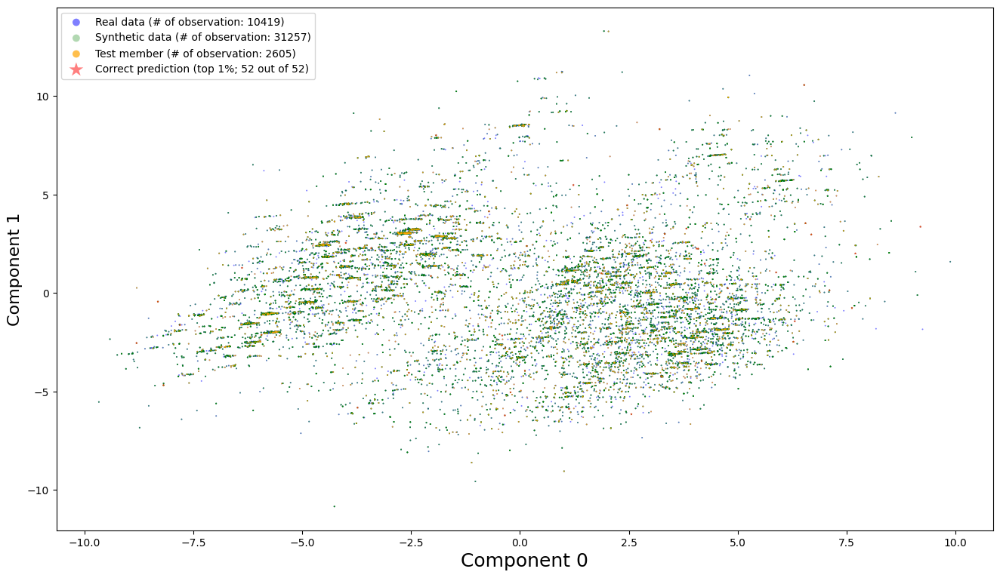

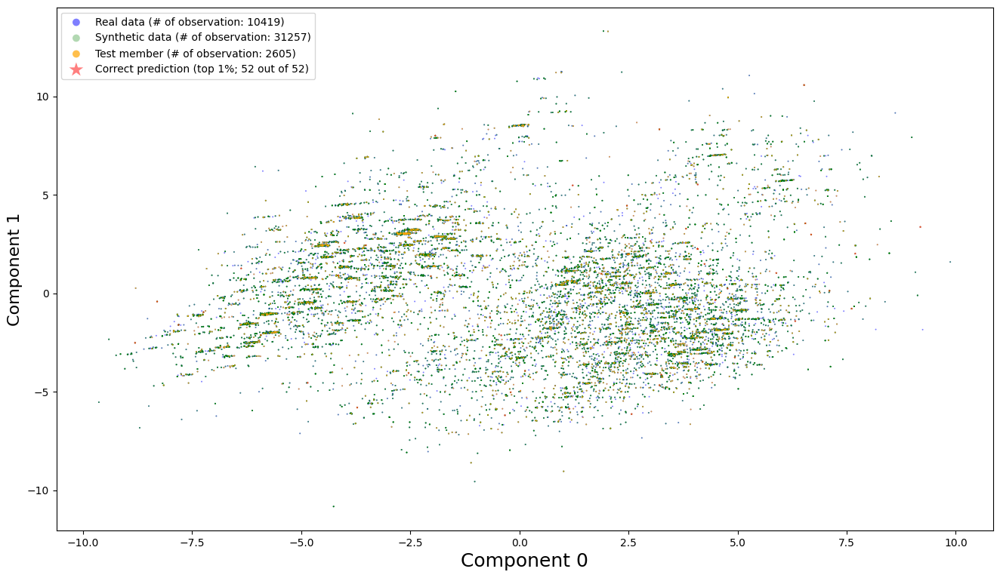

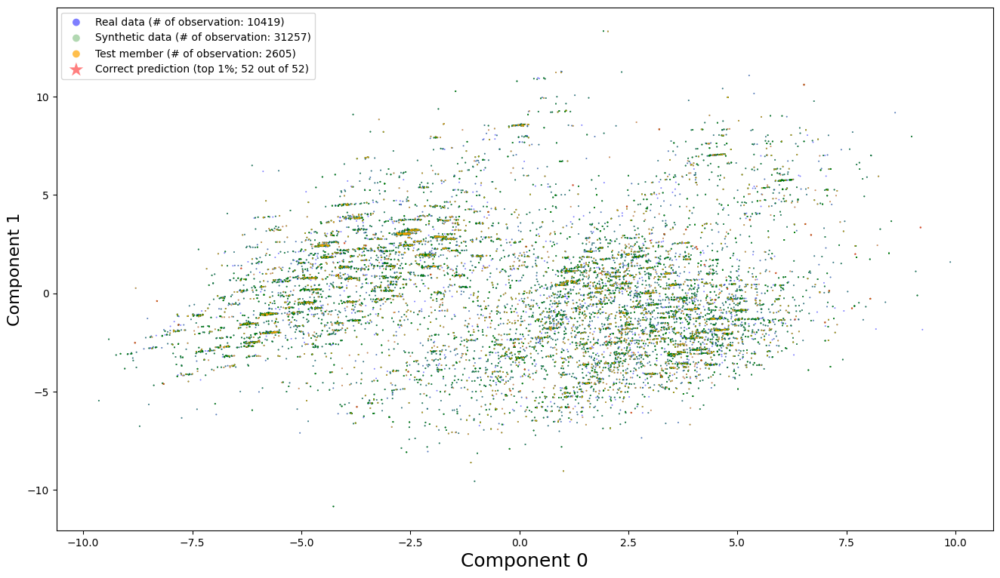

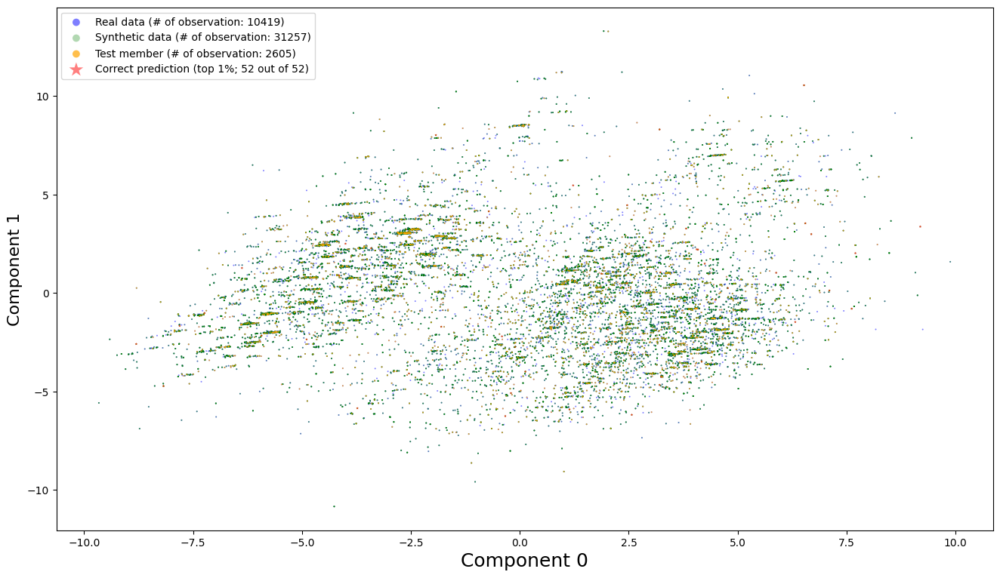

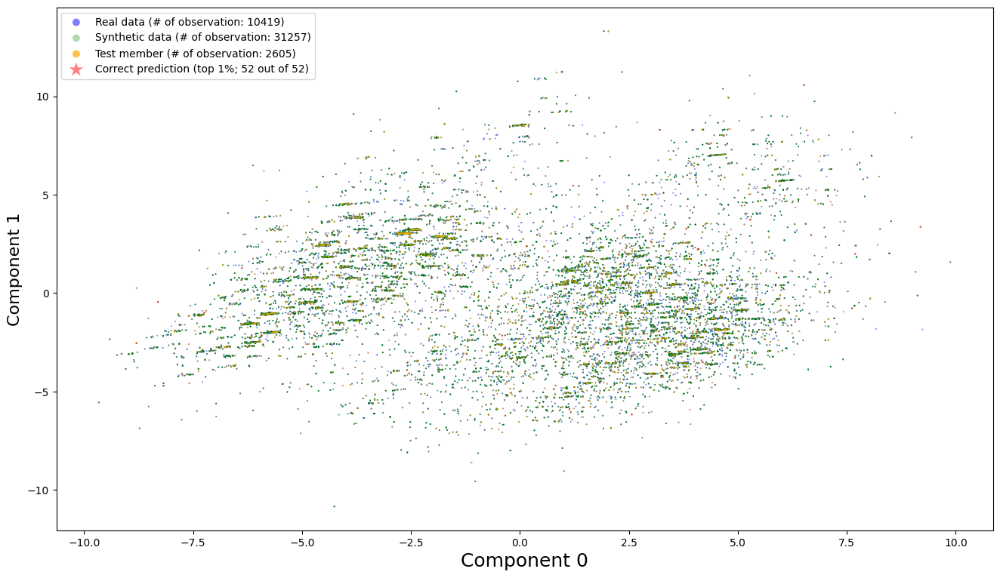

In [8]:
# GANLeaks
print("GANLeaks")
precision_top1_ganleaks, precision_top50_ganleaks = GAN_Leaks.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_test=df_test,
    y_test=y_test,
    metadata=config.metadata,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# MC Membership
print("MC Membership")
precision_top1_mcmembership, precision_top50_mcmembership = Monte_Carlo.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_test=df_test,
    y_test=y_test,
    metadata=config.metadata,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# LOGAN
print("LOGAN")
precision_top1_logan, precision_top50_logan = LOGAN.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_logan=df_train_logan,
    y_train_logan=y_train_logan,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# TableGAN
print("")
precision_top1_tablegan, precision_top50_tablegan = TableGAN.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_tablegan_discriminator=df_train_tablegan_discriminator,
    y_train_tablegan_discriminator=y_train_tablegan_discriminator,
    df_train_tablegan_classifier=df_train_tablegan_classifier,
    y_train_tablegan_classifier=y_train_tablegan_classifier,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# Detector
print("Detector")
precision_top1_detector, precision_top50_detector = Detector.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_detector=df_train_detector,
    y_train_detector=y_train_detector,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# Soft voting
print("Soft voting")
precision_top1_voting, precision_top50_voting = soft_voting.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_logan=df_train_logan,
    y_train_logan=y_train_logan,
    df_train_tablegan_discriminator=df_train_tablegan_discriminator,
    y_train_tablegan_discriminator=y_train_tablegan_discriminator,
    df_train_tablegan_classifier=df_train_tablegan_classifier,
    y_train_tablegan_classifier=y_train_tablegan_classifier,
    df_train_detector=df_train_detector,
    y_train_detector=y_train_detector,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# Stacking
print("Stacking")
precision_top1_stacking, precision_top50_stacking = stacking.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_logan=df_train_logan,
    y_train_logan=y_train_logan,
    df_train_tablegan_discriminator=df_train_tablegan_discriminator,
    y_train_tablegan_discriminator=y_train_tablegan_discriminator,
    df_train_tablegan_classifier=df_train_tablegan_classifier,
    y_train_tablegan_classifier=y_train_tablegan_classifier,
    df_train_detector=df_train_detector,
    y_train_detector=y_train_detector,
    df_val=df_val,
    y_val=y_val,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# Stacking+
print("Stacking+")
precision_top1_stacking_plus, precision_top50_stacking_plus = stacking_plus.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_logan=df_train_logan,
    y_train_logan=y_train_logan,
    df_train_tablegan_discriminator=df_train_tablegan_discriminator,
    y_train_tablegan_discriminator=y_train_tablegan_discriminator,
    df_train_tablegan_classifier=df_train_tablegan_classifier,
    y_train_tablegan_classifier=y_train_tablegan_classifier,
    df_train_detector=df_train_detector,
    y_train_detector=y_train_detector,
    df_val=df_val,
    y_val=y_val,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# Blending
print("Blending")
precision_top1_blending, precision_top50_blending = blending.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_logan=df_train_logan,
    y_train_logan=y_train_logan,
    df_train_tablegan_discriminator=df_train_tablegan_discriminator,
    y_train_tablegan_discriminator=y_train_tablegan_discriminator,
    df_train_tablegan_classifier=df_train_tablegan_classifier,
    y_train_tablegan_classifier=y_train_tablegan_classifier,
    df_train_detector=df_train_detector,
    y_train_detector=y_train_detector,
    df_val=df_val,
    y_val=y_val,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# Blending+
print("Blending+")
precision_top1_blending_plus, precision_top50_blending_plus = blending_plus.model(
    df_real_train=df_real_train,
    df_synth_train=df_synth_train,
    df_synth_test=df_synth_test,
    df_train_logan=df_train_logan,
    y_train_logan=y_train_logan,
    df_train_tablegan_discriminator=df_train_tablegan_discriminator,
    y_train_tablegan_discriminator=y_train_tablegan_discriminator,
    df_train_tablegan_classifier=df_train_tablegan_classifier,
    y_train_tablegan_classifier=y_train_tablegan_classifier,
    df_train_detector=df_train_detector,
    y_train_detector=y_train_detector,
    df_val=df_val,
    y_val=y_val,
    df_test=df_test,
    y_test=y_test,
    cont_cols=cont_cols,
    cat_cols=cat_cols,
    iteration=iteration,
    save_path=config.OUTPUT_PATH / generator / "plot",
    seed=config.seed,
)

# 3. Results

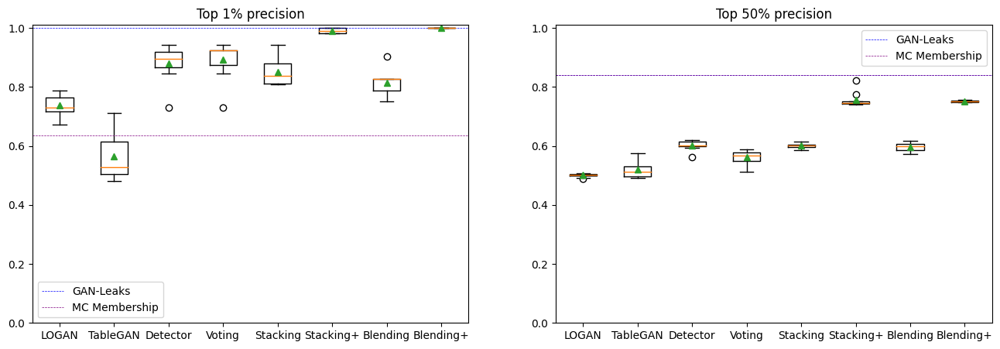

In [9]:
names = [
    "LOGAN",
    "TableGAN",
    "Detector",
    "Voting",
    "Stacking",
    "Stacking+",
    "Blending",
    "Blending+",
]
precision_top1_results = [
    precision_top1_logan,
    precision_top1_tablegan,
    precision_top1_detector,
    precision_top1_voting,
    precision_top1_stacking,
    precision_top1_stacking_plus,
    precision_top1_blending,
    precision_top1_blending_plus,
]
precision_top50_results = [
    precision_top50_logan,
    precision_top50_tablegan,
    precision_top50_detector,
    precision_top50_voting,
    precision_top50_stacking,
    precision_top50_stacking_plus,
    precision_top50_blending,
    precision_top50_blending_plus,
]

ganleaks_results = precision_top1_ganleaks, precision_top50_ganleaks
mcmembership_results = precision_top1_mcmembership, precision_top50_mcmembership

draw.compare_results(
    names=names,
    precision_top1_results=precision_top1_results,
    precision_top50_results=precision_top50_results,
    ganleaks_results=ganleaks_results,
    mcmembership_results=mcmembership_results,
    save_path=config.OUTPUT_PATH / generator / "plot" / "results_comparison.jpg",
)